# Dolomiti's region, province and municipalities

### Set up

In [31]:
import geopandas as gpd
import contextily as ctx
import pandas as pd
import matplotlib.pyplot as plt
from functions import *

## Dolomiti's regions, provinces and municipalities ranking lists
As mentioned in the introduction, the Dolomites are spread over several Italian regions, and consequently Italian provinces and municipalities. What are these regions, provinces and municipalities? And which of them contains the majority of the peaks?
In this notebook we will build three ranking list indicating the percentage of the Dolomites contained in regions, provinces and municipalities involved in the area.

### Import Dolomiti's CSV file and convert it in a GeoDataFrame
First, it is essential to import Dolomiti's data (remember that we save it in csv format).

In [32]:
df_dolomities = pd.read_csv('data\df_dolomities.csv')
df_dolomities.head(4)

,Name,Description,geometry,area,centroids
0,"Sistema 1 - Pelmo, Croda da Lago","Esplora il Sistema 1 Pelmo, Croda da Lago su<b...","POLYGON Z ((12.121421 46.404879 0, 12.121488 4...",4.315303e+07,POINT (739351.9373813267 5148262.480977141)
1,Sistema 2 - Marmolada,Esplora il Sistema 2 Marmolada su<br>http://ww...,"POLYGON Z ((11.823194 46.452963 0, 11.822142 4...",2.205786e+07,POINT (719424.1649959779 5145963.68184033)
2,"Sistema 3 - Pale di San Martino, San Lucano, D...","Esplora il Sistema 3 Pale di San Martino, San ...","POLYGON Z ((11.98683 46.317204 0, 11.988004 46...",3.165677e+08,POINT (730679.3390335406 5125674.431470685)
3,Sistema 4 - Dolomiti friulane e d'Oltre Piave,Esplora il Sistema 4 Dolomiti friulane e d'Olt...,"POLYGON Z ((12.512045 46.424872 0, 12.512 46.4...",2.146157e+08,POINT (769747.0350640987 5138937.349145058)


In [33]:
type(df_dolomities)

pandas.core.frame.DataFrame

Build the GeoDataFrame from the DataFrame using `geopandas`' `GeoDataFrame()`:

In [34]:
# retrieve geometry with geopandas' GeoSeries.from_wkt()
geometry = gpd.GeoSeries.from_wkt(df_dolomities['geometry'])
geodf_dolomities = gpd.GeoDataFrame(df_dolomities, geometry=geometry, crs="EPSG:4326")
geodf_dolomities.head(4)

,Name,Description,geometry,area,centroids
0,"Sistema 1 - Pelmo, Croda da Lago","Esplora il Sistema 1 Pelmo, Croda da Lago su<b...","POLYGON Z ((12.12142 46.40488 0.00000, 12.1214...",4.315303e+07,POINT (739351.9373813267 5148262.480977141)
1,Sistema 2 - Marmolada,Esplora il Sistema 2 Marmolada su<br>http://ww...,"POLYGON Z ((11.82319 46.45296 0.00000, 11.8221...",2.205786e+07,POINT (719424.1649959779 5145963.68184033)
2,"Sistema 3 - Pale di San Martino, San Lucano, D...","Esplora il Sistema 3 Pale di San Martino, San ...","POLYGON Z ((11.98683 46.31720 0.00000, 11.9880...",3.165677e+08,POINT (730679.3390335406 5125674.431470685)
3,Sistema 4 - Dolomiti friulane e d'Oltre Piave,Esplora il Sistema 4 Dolomiti friulane e d'Olt...,"POLYGON Z ((12.51205 46.42487 0.00000, 12.5120...",2.146157e+08,POINT (769747.0350640987 5138937.349145058)


In [35]:
type(geodf_dolomities)

geopandas.geodataframe.GeoDataFrame

We can also load the GeoDataFrame using a costum function from `functions.py`:

In [36]:
geodf_dolomities = load_geodf_dolomities('data\I nove Sistemi delle Dolomiti UNESCO.kml')

### Get region, provinces and municipality
it is now essential to import data about regions, provinces and municipalities (again, we use a custom function).
We use [ISTAT](https://www.istat.it/storage/cartografia/confini_amministrativi/generalizzati/Limiti01012021_g.zip) data used during the course.


In [37]:
download_extract('data\Limiti01012021_g', 'https://www.istat.it/storage/cartografia/confini_amministrativi/generalizzati/Limiti01012021_g.zip')

In [38]:
regions_path = "data\Limiti01012021_g\Reg01012021_g"
regions = gpd.read_file(regions_path)
regions = regions.to_crs(epsg=4326)[['COD_REG', 'DEN_REG', 'Shape_Area', 'geometry']]

provinces_path = "data\Limiti01012021_g\ProvCM01012021_g"
provinces = gpd.read_file(provinces_path)
provinces = provinces.to_crs(epsg=4326)[['COD_REG', 'COD_PROV', 'DEN_PROV', 'Shape_Area', 'geometry']]

# join data about province with the data about the region they belong to
prov_reg = gpd.sjoin(provinces, regions, how='left', predicate='within', lsuffix='', rsuffix='reg')

municipalities_path = "data\Limiti01012021_g\Com01012021_g"
municipalities = gpd.read_file(municipalities_path)
municipalities = municipalities.to_crs(epsg=4326)[['COD_REG', 'COD_PROV', 'PRO_COM_T', 'COMUNE', 'Shape_Area', 'geometry']]

# join data about minicipalities with the data about the province and region they belong to
prov_reg_mun = gpd.sjoin(municipalities, prov_reg, how='left', predicate='within', lsuffix='', rsuffix='prov')


### Join Dolomiti's and regions and provinces data

We ues spatial join with **intersect** predicate in order to join data about Dolomiti systems and regions and provinces.

In [39]:
geodf_dolomities_provices = gpd.sjoin(geodf_dolomities, prov_reg, how='left', predicate='intersects', lsuffix='dolomities', rsuffix='provinces')
geodf_dolomities_provices = geodf_dolomities_provices[['Name', 'Description', 'geometry', 'area', 'COD_REG_', 'COD_PROV', 'DEN_PROV', 'Shape_Area_', 'DEN_REG', 'Shape_Area_reg']]
geodf_dolomities_provices.head(4)

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
0,"Sistema 1 - Pelmo, Croda da Lago","Esplora il Sistema 1 Pelmo, Croda da Lago su<b...","POLYGON Z ((12.12142 46.40488 0.00000, 12.1214...",4.315303e+07,5,25,Belluno,3.609841e+09,Veneto,1.834355e+10
1,Sistema 2 - Marmolada,Esplora il Sistema 2 Marmolada su<br>http://ww...,"POLYGON Z ((11.82319 46.45296 0.00000, 11.8221...",2.205786e+07,5,25,Belluno,3.609841e+09,Veneto,1.834355e+10
1,Sistema 2 - Marmolada,Esplora il Sistema 2 Marmolada su<br>http://ww...,"POLYGON Z ((11.82319 46.45296 0.00000, 11.8221...",2.205786e+07,4,22,Trento,6.208170e+09,Trentino-Alto Adige,1.360755e+10
2,"Sistema 3 - Pale di San Martino, San Lucano, D...","Esplora il Sistema 3 Pale di San Martino, San ...","POLYGON Z ((11.98683 46.31720 0.00000, 11.9880...",3.165677e+08,5,25,Belluno,3.609841e+09,Veneto,1.834355e+10


Now we have a DataFrame with systems and the regions/provinces containing them. 

E.g. *Sistema 2 - Marmolada* is contained in both Veneto and Trentino Alto Adige, in particular between province of Belluno (Venento) and province of Trento ( Trentino Alto Adige).

### Plot Dolomiti systems over regions that contains them

We first extract the Dolomiti's regions' name from the previous data:

In [40]:
dolomiti_regions = geodf_dolomities_provices.DEN_REG.unique()
geo_dolomiti_regions = regions[regions.DEN_REG.isin(dolomiti_regions)]

print("Dolomiti regions: ")
for i in geo_dolomiti_regions.DEN_REG.unique():
    print("-", i, end="\n")

Dolomiti regions: 
- Trentino-Alto Adige
- Veneto
- Friuli Venezia Giulia


Plot data on overall Italian terriroty:

<AxesSubplot:>

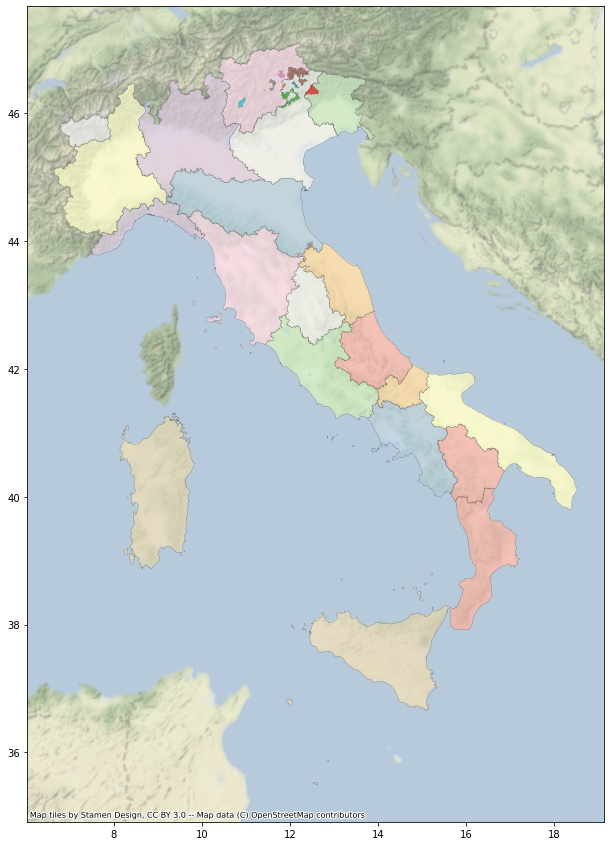

In [41]:
base = regions.to_crs(epsg=4326).plot(
    column='DEN_REG',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, crs=geo_dolomiti_regions.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


geodf_dolomities.plot(
    column='Name',
    ax=base,
    edgecolor="k",
    alpha=0.75,
    lw=0.1
    )

Let's zoom over the regions that contain Dolomiti:

In [42]:
representative_points_region = representative_points_for_labels(geo_dolomiti_regions, 'DEN_REG')
representative_points_region

,index,geometry,names
0,3,POINT (11.22145 46.38468),Trentino-Alto Adige
1,4,POINT (12.09621 45.73561),Veneto
2,5,POINT (13.04718 46.11426),Friuli Venezia Giulia


Plot the zoomed map with the regions name labels:

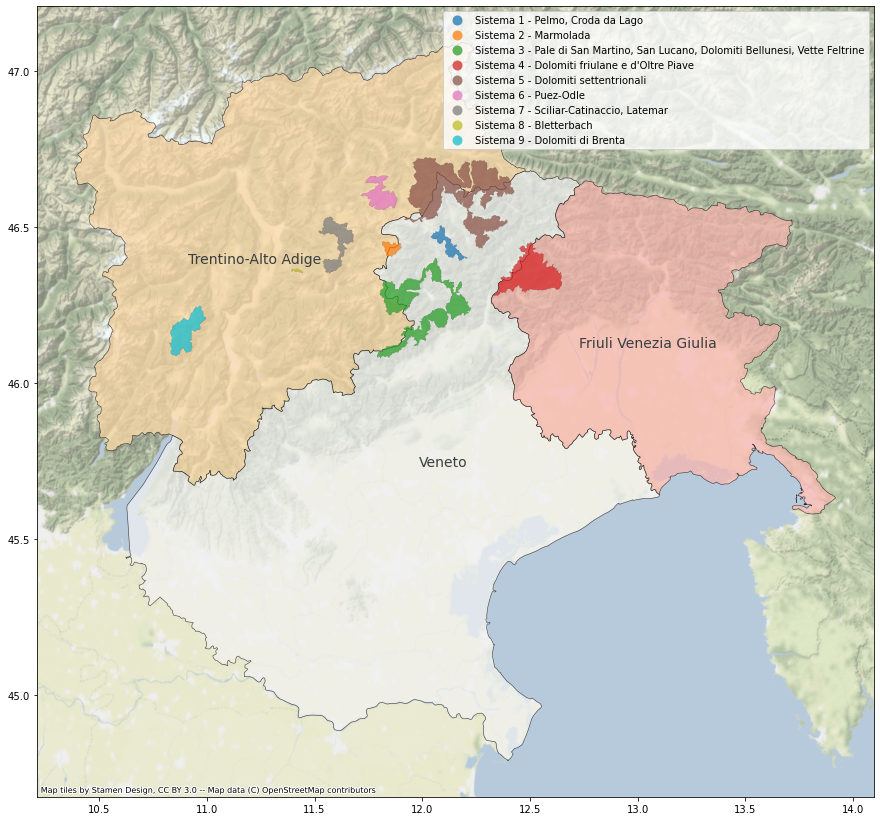

In [43]:
texts = []

base = geo_dolomiti_regions.to_crs(epsg=4326).plot(
    column='DEN_REG',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.6,
    alpha=0.7
    )
ctx.add_basemap(base, crs=geo_dolomiti_regions.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


geodf_dolomities.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.75,
    lw=0.1
    )

for x, y, label in zip(representative_points_region.to_crs(epsg=4326).geometry.x, representative_points_region.to_crs(epsg=4326).geometry.y, representative_points_region["names"]):
    texts.append(plt.text(x, y, label, fontsize = 14, color="#393e41", fontweight='regular', fontfamily='sans-serif', horizontalalignment='center'))

### Which region contains the majority of the Dolomiti's peaks?

In [44]:
list_reg = []
list_dol_area = []
list_dol_percentage = []

for i in geo_dolomiti_regions.DEN_REG.unique():
    temp = regions_systems_percentage(i, geodf_dolomities)
    
    list_reg.append(temp[0])
    list_dol_area.append(temp[1])
    list_dol_percentage.append(temp[2])

45.59% of the Dolomiti's peaks is in Trentino-Alto Adige with 646.86 km²
41.2% of the Dolomiti's peaks is in Veneto with 584.6 km²
13.2% of the Dolomiti's peaks is in Friuli Venezia Giulia with 187.35 km²


Save results:

In [45]:
rank_dolomiti_reg = pd.DataFrame(list(zip(list_reg, list_dol_area, list_dol_percentage)),
               columns =['region', 'dolomiti_area_km', 'percentage_over_total_dolimiti_area'])

rank_dolomiti_reg

,region,dolomiti_area_km,percentage_over_total_dolimiti_area
0,Trentino-Alto Adige,646.86,45.59
1,Veneto,584.60,41.20
2,Friuli Venezia Giulia,187.35,13.20


The region with the majority of Dolomiti is **Trentino-Alto Adige**, followed by Veneto and Friuli Venezia Giulia.

As we can see from the previous plots, only few territories of these region effectively contain Dolomiti systems, let's indagate through their provinces.

### Plot Dolomiti systems over provinces containing them

In [46]:
dolomiti_provinces = geodf_dolomities_provices.DEN_PROV.unique()
geo_dolomiti_provinces = provinces[provinces.DEN_PROV.isin(dolomiti_provinces)]

print("Dolomiti provinces: ")
for i in geo_dolomiti_provinces.DEN_PROV.unique():
    print("-", i, end="\n")


Dolomiti provinces: 
- Bolzano
- Trento
- Belluno
- Udine
- Pordenone


Get the provincial capital using the `city_coordinates_label` custom function:

In [47]:
geo_capoluighi = city_coordinates_label(geo_dolomiti_provinces, 'DEN_PROV')
geo_capoluighi

,geometry,DEN_PROV
0,POINT (11.35346 46.49528),Bolzano
1,POINT (11.11929 46.07005),Trento
2,POINT (12.21275 46.14098),Belluno
3,POINT (13.23807 46.06452),Udine
4,POINT (12.64453 45.96493),Pordenone


Plot the Dolomiti systems over their provinces with provincial capitals labels:

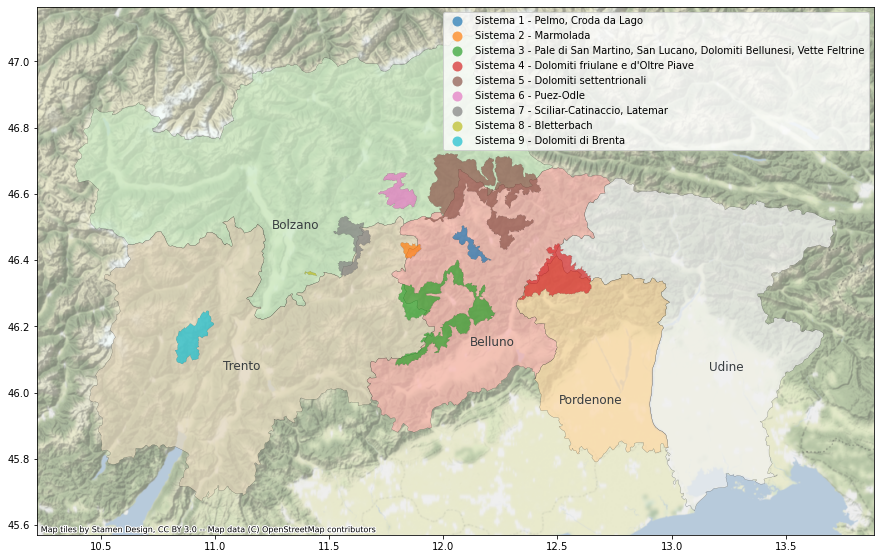

In [48]:
base = geo_dolomiti_provinces.to_crs(epsg=4326).plot(
    column='DEN_PROV',
    categorical=True,
    legend=True,
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, crs=geo_dolomiti_provinces.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


geodf_dolomities.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

for x, y, label in zip(geo_capoluighi.to_crs(epsg=4326).geometry.x, geo_capoluighi.to_crs(epsg=4326).geometry.y, geo_capoluighi['DEN_PROV']):
    texts.append(plt.text(x, y, label, fontsize = 12, color="#393e41", fontweight='regular', fontfamily='sans-serif', horizontalalignment='center'))


## Dolomiti's province and municipalities analysis

We have just seen the ranking for the Dolomiti's regions. The following sections will instead determine which provinces and municipalities contain the majority of the territory of the Dolomites.


### Province of Trento

The province of Trento, together with the province of Bolzano, constitute the region with the higher percentage of Dolomiti's peaks: Trentino Alto-Adige.

Get province GeoDataFrame and plot it:

In [49]:
province_TN = provinces[provinces.DEN_PROV == 'Trento']
province_TN

,COD_REG,COD_PROV,DEN_PROV,Shape_Area,geometry
21,4,22,Trento,6.208170e+09,"POLYGON ((11.82408 46.50408, 11.81545 46.50032..."


<AxesSubplot:>

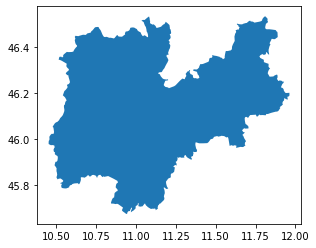

In [50]:
province_TN.plot()

Extract Dolomiti systems of province of Trento and plot them:

In [51]:
dolomities_TN = geodf_dolomities_provices[geodf_dolomities_provices.DEN_PROV == province_TN.DEN_PROV.values[0]]
dolomities_TN

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
1,Sistema 2 - Marmolada,Esplora il Sistema 2 Marmolada su<br>http://ww...,"POLYGON Z ((11.82319 46.45296 0.00000, 11.8221...",2.205786e+07,4,22,Trento,6.208170e+09,Trentino-Alto Adige,1.360755e+10
2,"Sistema 3 - Pale di San Martino, San Lucano, D...","Esplora il Sistema 3 Pale di San Martino, San ...","POLYGON Z ((11.98683 46.31720 0.00000, 11.9880...",3.165677e+08,4,22,Trento,6.208170e+09,Trentino-Alto Adige,1.360755e+10
6,"Sistema 7 - Sciliar-Catinaccio, Latemar","Esplora il Sistema 7 Sciliar-Catinaccio, Latem...","POLYGON Z ((11.51976 46.48659 0.00000, 11.5202...",9.302092e+07,4,22,Trento,6.208170e+09,Trentino-Alto Adige,1.360755e+10
8,Sistema 9 - Dolomiti di Brenta,Esplora il Sistema 9 Dolomiti di Brenta su<br>...,"POLYGON Z ((10.97380 46.24359 0.00000, 10.9735...",1.113544e+08,4,22,Trento,6.208170e+09,Trentino-Alto Adige,1.360755e+10


In [52]:
print('province of ', province_TN.DEN_PROV.values[0], ' contains ', len(dolomities_TN.Name.unique()), " Dolomiti systems:", sep="")
for i in dolomities_TN.Name.unique():
    print("-", i, end="\n")

province of Trento contains 4 Dolomiti systems:
- Sistema 2 - Marmolada
- Sistema 3 - Pale di San Martino, San Lucano, Dolomiti Bellunesi, Vette Feltrine
- Sistema 7 - Sciliar-Catinaccio, Latemar
- Sistema 9 - Dolomiti di Brenta


<AxesSubplot:>

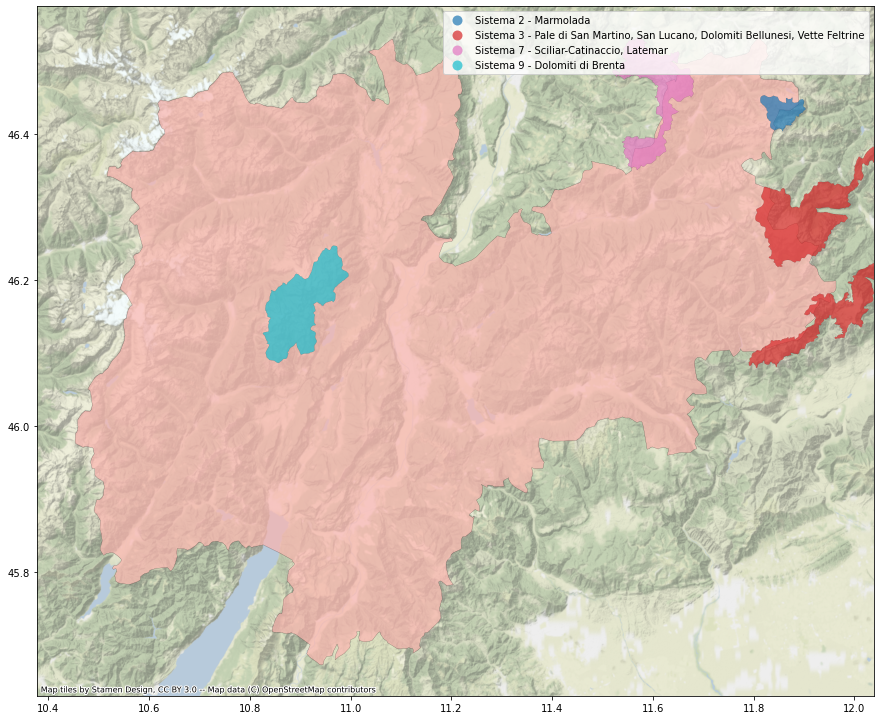

In [53]:
base = province_TN.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_TN.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_TN.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

#### Clip the Dolomiti systems geometry in order to have only the territory inside the province boudaries

As we can see from the plot, the province hardly ever contains the whole territory of a system. Using `geopandas`' `clip()` we then crop the area of each system on the province boundaries.

In [54]:
dolomities_TN_clipped = dolomities_TN.clip(province_TN)

<AxesSubplot:>

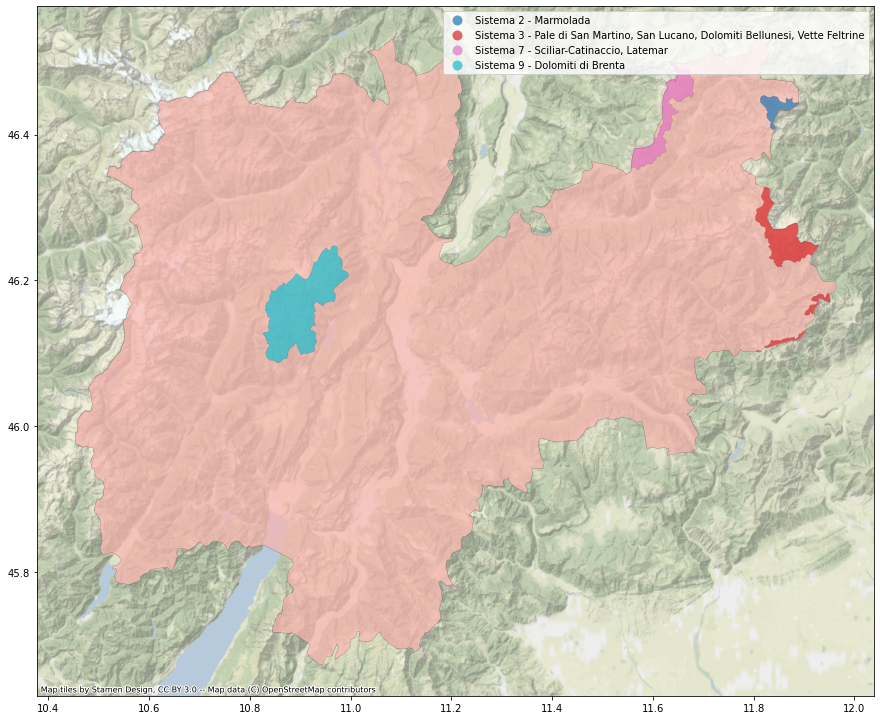

In [55]:
base = province_TN.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_TN.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_TN_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

#### Recalculate clipped Dolomiti's territory area

As a consequence of clipping, it is necessary to recalculate the area of each system:

In [56]:
dolomities_TN_clipped_areas= dolomities_TN_clipped.to_crs(epsg=32632)
dolomities_TN_clipped_areas["area"] = dolomities_TN_clipped_areas['geometry'].area
dolomities_TN_clipped_areas

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
8,Sistema 9 - Dolomiti di Brenta,Esplora il Sistema 9 Dolomiti di Brenta su<br>...,"POLYGON ((652158.161 5122687.179, 652162.795 5...",1.113544e+08,4,22,Trento,6.208170e+09,Trentino-Alto Adige,1.360755e+10
2,"Sistema 3 - Pale di San Martino, San Lucano, D...","Esplora il Sistema 3 Pale di San Martino, San ...","MULTIPOLYGON (((725381.201 5115301.937, 725290...",4.579665e+07,4,22,Trento,6.208170e+09,Trentino-Alto Adige,1.360755e+10
1,Sistema 2 - Marmolada,Esplora il Sistema 2 Marmolada su<br>http://ww...,"POLYGON ((718275.208 5143106.310, 718245.759 5...",1.148806e+07,4,22,Trento,6.208170e+09,Trentino-Alto Adige,1.360755e+10
6,"Sistema 7 - Sciliar-Catinaccio, Latemar","Esplora il Sistema 7 Sciliar-Catinaccio, Latem...","MULTIPOLYGON (((700185.820 5141183.564, 700337...",3.898385e+07,4,22,Trento,6.208170e+09,Trentino-Alto Adige,1.360755e+10


Sum the Dolomiti's areas in Trentino:

In [57]:
dolomiti_TN_area = sum(dolomities_TN_clipped_areas.area)
print(round(dolomiti_TN_area/10**6, 2), " km\u00b2 of Dolomiti are in province of Trento", sep="")


207.62 km² of Dolomiti are in province of Trento


Let's plot the Dolomiti's areas as difference difference overlay, to give an idea of their impact over the province territory.

<AxesSubplot:>

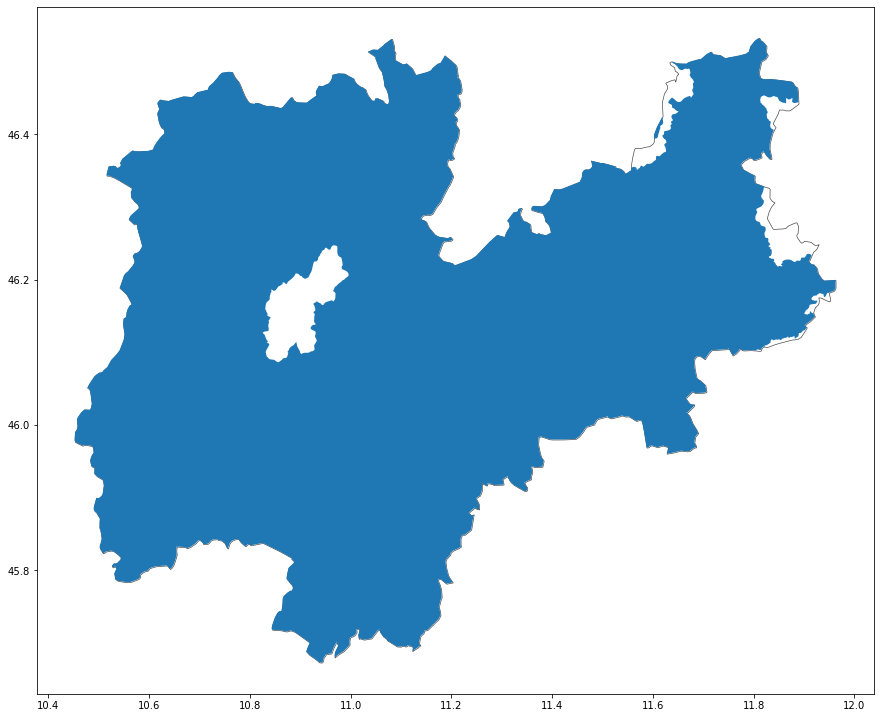

In [58]:
dolomiti_TN_overlay = province_TN.to_crs(epsg=32632).overlay(dolomities_TN_clipped.to_crs(epsg=32632), how="difference")
base = province_TN.to_crs(epsg=4326).plot(
    figsize=(15,15),
    color= "white",
    edgecolor="k",
    lw=0.7,
    alpha=0.7
    )
dolomiti_TN_overlay.to_crs(epsg=4326).plot(ax=base)

#### Proportion of Dolomiti's territory in province of Trento

It is possible to calculate the proportion of Dolomiti over the province of Trento by getting the Dolomiti's area for the province and dividing it for the whole area of the Dolomiti.

In [59]:
dolomiti_TN_area = sum(dolomities_TN_clipped_areas.area)
overal_dolomiti_area = sum(geodf_dolomities['area'])

In [60]:
persentage_dolomiti_TN = (dolomiti_TN_area/overal_dolomiti_area)*100

print("Province of Trento contains the ", round(persentage_dolomiti_TN, 2), "% of the Dolomiti's terriotory", sep="")

Province of Trento contains the 14.63% of the Dolomiti's terriotory


#### What proportion of each system does the province contain?

As mentioned earlier the province hardly ever contains the whole territory of a system, let's see how much system's territory it contains in percentage.

In [61]:
# function to obtain the percentage of each Dolomitic system in the province
def province_systems_percentage(province, system):
    
    # get the province GeoDataFrame
    province_geodf = provinces[provinces.DEN_PROV == province]
    
    # get the system GeoDataFrame
    system_geodf = geodf_dolomities[geodf_dolomities.Name == system]
    # calculate system's area
    system_area = geodf_dolomities[geodf_dolomities.Name == system]['area'].values[0]
    
    # clip the system shape on the province boundaries recalculating area
    system_area_clipped = system_geodf.to_crs(epsg=32632).clip(province_geodf.to_crs(epsg=32632)).area
    # calculate the percentage
    percentage_of_system = (system_area_clipped.values[0]/system_area)*100

    print(round(percentage_of_system, 2), "% of the", " '",system,"' ", "is in province of ", province, sep="")

In [62]:
for index, row in dolomities_TN.iterrows():
    province_systems_percentage(row.DEN_PROV, row.Name)

52.08% of the 'Sistema 2 - Marmolada' is in province of Trento
14.47% of the 'Sistema 3 - Pale di San Martino, San Lucano, Dolomiti Bellunesi, Vette Feltrine' is in province of Trento
41.91% of the 'Sistema 7 - Sciliar-Catinaccio, Latemar' is in province of Trento
100.0% of the 'Sistema 9 - Dolomiti di Brenta' is in province of Trento


As we can see also in the previous plot, the province of Trento contains the whole terriotry of *Sistema 9*, half of *Sistema 2* and other portions of *Sistema 3* e *Sistema 7*.

### Dolomiti's municipalities of province of Trento

The province of Trento contains four systems, but these cover only a small part of its territory. Let's find out which municipalities of the province contain Dolomiti's areas.

#### Join geodf_dolomities with provinces and regions

Using spatial join with **intersect** predicate.

In [63]:
geodf_dolomities_municipalities = gpd.sjoin(geodf_dolomities, prov_reg_mun, how='left', predicate='intersects', lsuffix='dolomities', rsuffix='mun')
geodf_dolomities_municipalities = geodf_dolomities_municipalities[['Name', 'Description', 'geometry', 'area', 'COD_REG', 'COD_PROV_', 'PRO_COM_T', 'COMUNE', 'Shape_Area', 'DEN_PROV', 'DEN_REG']]
geodf_dolomities_municipalities.head(4)

,Name,Description,geometry,area,COD_REG,COD_PROV_,PRO_COM_T,COMUNE,Shape_Area,DEN_PROV,DEN_REG
0,"Sistema 1 - Pelmo, Croda da Lago","Esplora il Sistema 1 Pelmo, Croda da Lago su<b...","POLYGON Z ((12.12142 46.40488 0.00000, 12.1214...",4.315303e+07,5,25,025073,Val di Zoldo,1.414058e+08,Belluno,Veneto
0,"Sistema 1 - Pelmo, Croda da Lago","Esplora il Sistema 1 Pelmo, Croda da Lago su<b...","POLYGON Z ((12.12142 46.40488 0.00000, 12.1214...",4.315303e+07,5,25,025069,ZoppÃ¨ di Cadore,4.585119e+06,Belluno,Veneto
0,"Sistema 1 - Pelmo, Croda da Lago","Esplora il Sistema 1 Pelmo, Croda da Lago su<b...","POLYGON Z ((12.12142 46.40488 0.00000, 12.1214...",4.315303e+07,5,25,025066,Vodo Cadore,4.671745e+07,Belluno,Veneto
0,"Sistema 1 - Pelmo, Croda da Lago","Esplora il Sistema 1 Pelmo, Croda da Lago su<b...","POLYGON Z ((12.12142 46.40488 0.00000, 12.1214...",4.315303e+07,5,25,025007,Borca di Cadore,2.669519e+07,Belluno,Veneto


In this Dataset we have all the municipalities involved in the territory with data on the corresponding province, region and Dolomiti systems.

E.g. *Val di Zoldo* is a municipality in province of Belluno, in Veneto, and it contains a portion of *Sistema 1 - Pelmo, Croda da Lago*.

#### Get municipalities of province of Trento

In [64]:
code_TN = province_TN.COD_PROV.values[0]
code_TN

22

In [65]:
municipalities_TN = municipalities[municipalities.COD_PROV == code_TN]
municipalities_TN.head(4)

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
2871,4,22,022001,Ala,1.200270e+08,"POLYGON ((11.00066 45.82692, 11.00103 45.82634..."
2872,4,22,022002,Albiano,9.804277e+06,"POLYGON ((11.20754 46.15620, 11.20994 46.15454..."
2873,4,22,022003,Aldeno,9.035749e+06,"POLYGON ((11.10303 45.99093, 11.11333 45.98973..."
2874,4,22,022005,Andalo,1.141823e+07,"MULTIPOLYGON (((10.95317 46.13797, 10.95315 46..."


<AxesSubplot:>

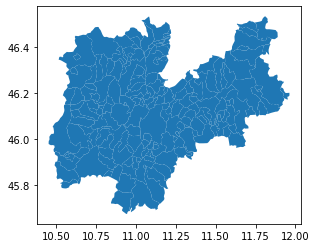

In [66]:
municipalities_TN.plot()

#### Get municipalities that contain Dolomiti's territory

In [67]:
dolomiti_mun = geodf_dolomities_municipalities.COMUNE.unique()
geo_dolomiti_TN_mun = municipalities_TN[municipalities_TN.COMUNE.isin(dolomiti_mun)]

print("Municipalities in province of Trento that contain Dolomiti: ")
for i in geo_dolomiti_TN_mun.COMUNE.unique():
    print("-", i, end="\n")

Municipalities in province of Trento that contain Dolomiti: 
- Andalo
- Campitello di Fassa
- Campodenno
- Canazei
- Cavedago
- Imer
- Mazzin
- Mezzano
- Moena
- Molveno
- Predazzo
- Sagron Mis
- Soraga di Fassa
- Spormaggiore
- Sporminore
- Stenico
- Comano Terme
- San Lorenzo Dorsino
- Primiero San Martino di Castrozza
- Tre Ville
- Ville d'Anaunia
- San Giovanni di Fassa


Plot these municipalities along with Dolomiti systems:

<AxesSubplot:>

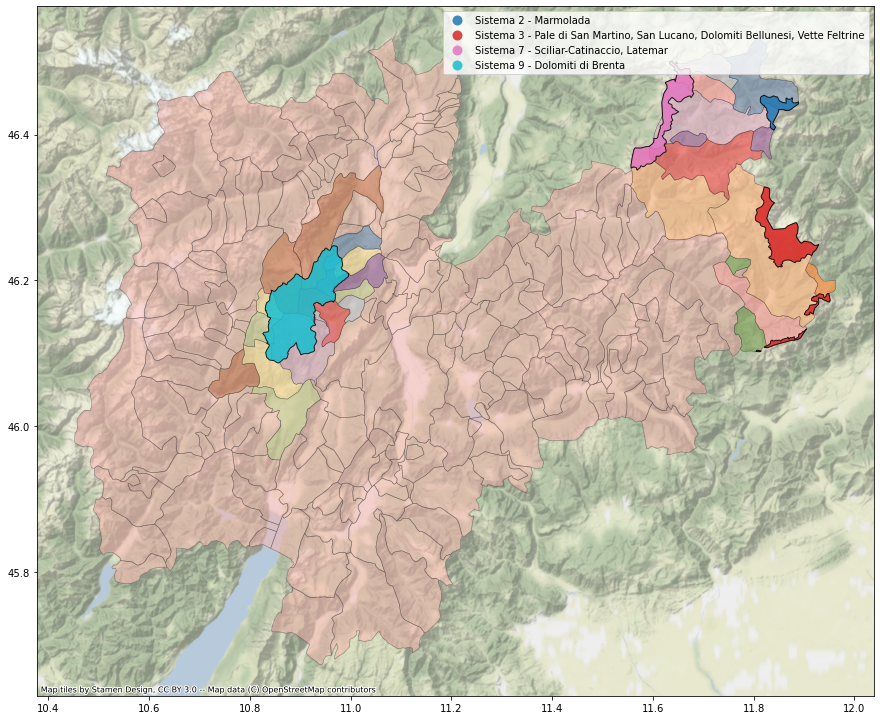

In [68]:
base = municipalities_TN.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="#413A3B",
    lw=0.6,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_TN.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

geo_dolomiti_TN_mun.to_crs(epsg=4326).plot(
    column='COMUNE',
    figsize=(15,15),
    cmap="Paired",
    edgecolor="k",
    lw=0.2,
    alpha=0.4,
    ax=base
    )

dolomities_TN_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.85,
    lw=1,
    )

As we can notice, not all shapes seem to touch a Dolomiti system. This is due to the fact that their municipality's geometry is Multipolygon.
Let's check this point:

In [69]:
multipoly_mun = geo_dolomiti_TN_mun[geo_dolomiti_TN_mun.geometry.geom_type == 'MultiPolygon']
multipoly_mun

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
2874,4,22,022005,Andalo,1.141823e+07,"MULTIPOLYGON (((10.95317 46.13797, 10.95315 46..."
2929,4,22,022097,Imer,2.782916e+07,"MULTIPOLYGON (((11.79596 46.15639, 11.79899 46..."
2983,4,22,022176,Soraga di Fassa,2.021369e+07,"MULTIPOLYGON (((11.69002 46.39827, 11.69068 46..."
2988,4,22,022182,Stenico,4.929662e+07,"MULTIPOLYGON (((10.84194 46.11319, 10.84293 46..."
3010,4,22,022228,Comano Terme,6.778564e+07,"MULTIPOLYGON (((10.91873 46.06429, 10.91921 46..."
3029,4,22,022247,Tre Ville,8.258386e+07,"MULTIPOLYGON (((10.78454 46.08734, 10.78580 46..."


Plot Multiplygon Dolomiti's municipalities:

<AxesSubplot:>

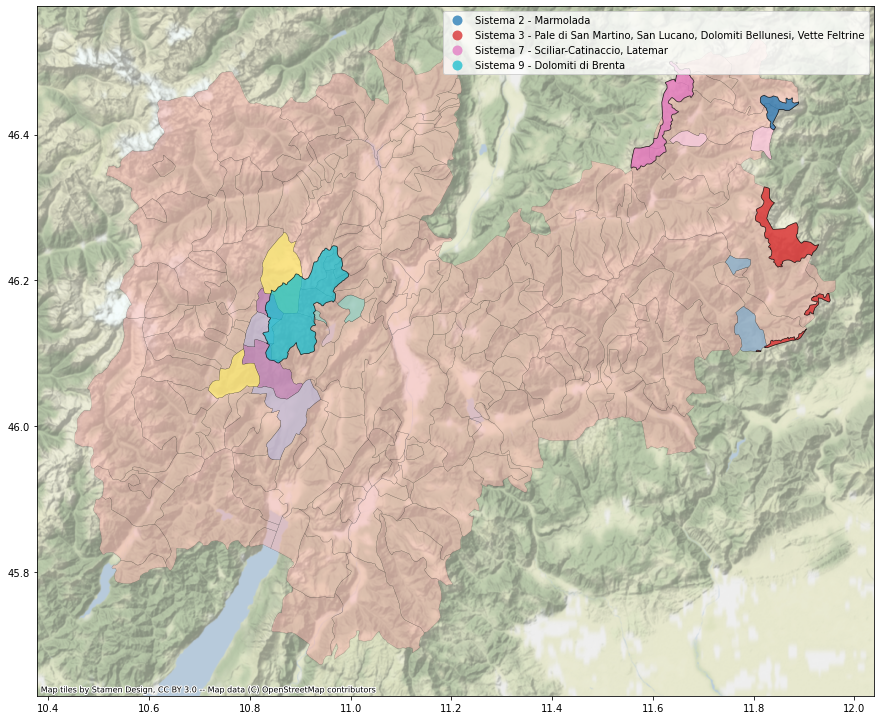

In [70]:
base = municipalities_TN.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_TN.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

multipoly_mun.to_crs(epsg=4326).plot(
    column='COMUNE',
    figsize=(15,15),
    cmap="Set3",
    edgecolor="k",
    lw=0.2,
    alpha=0.7,
    ax=base
    )

dolomities_TN_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.75,
    lw=0.8,
    )

#### Which is the municiplaity that contains the highest area of Dolomiti?

First, we create the Dolomiti area by dissolving the systems geometries.

In [71]:
# we add a column with the same value for each system in order to dissolve on this column
geodf_dolomities['territory']='dolomiti'

dolomiti = geodf_dolomities[['territory', 'geometry']]
overal_dolomiti = dolomiti.to_crs(epsg=4326).dissolve(by='territory')

Check the total area:

In [72]:
sum(geodf_dolomities['area'])

1418804775.9299965

Finnaly we build a function to obtain the percentage of Dolomiti territory in the involved municipalities:

In [73]:
def mun_systems_area(mun):
    
    # get municipality GeoDataFrame
    mun_geodf = municipalities[municipalities.COMUNE == mun]
    
    # calculate Dolomiti's total area
    system_geodf = geodf_dolomities
    systems_area = sum(geodf_dolomities['area'])
    
    # clip the system shape on the minicipality boundaries recalculating area
    system_area_clipped = overal_dolomiti.to_crs(epsg=32632).clip(mun_geodf.to_crs(epsg=32632)).area
    # calculate percentage
    percentage_dolomiti = (system_area_clipped/systems_area)*100

    print("'", mun, "'", " contains ", round(system_area_clipped.values[0]/10**6, 3), " km\u00b2 of Dolomities.", "and the ", round(percentage_dolomiti.values[0], 4), "% of the overall Dolomities territory", sep="")
    
    return [mun, system_area_clipped.values[0], percentage_dolomiti.values[0]]

We add the results of the function to lists to then compose a Dataset. This Dataset will contain the minicipality's name, the Dolomiti area contained in its boundaries and its percentage over the total Dolomit area.

In [74]:
list_mun = []
list_area = []
list_percentage = []

for index, row in geo_dolomiti_TN_mun.iterrows():
    temp = mun_systems_area(row.COMUNE)

    list_mun.append(temp[0])
    list_area.append(temp[1])
    list_percentage.append(temp[2])

'Andalo' contains 0.036 km² of Dolomities.and the 0.0026% of the overall Dolomities territory
'Campitello di Fassa' contains 2.175 km² of Dolomities.and the 0.1533% of the overall Dolomities territory
'Campodenno' contains 5.442 km² of Dolomities.and the 0.3836% of the overall Dolomities territory
'Canazei' contains 7.163 km² of Dolomities.and the 0.5048% of the overall Dolomities territory
'Cavedago' contains 0.348 km² of Dolomities.and the 0.0245% of the overall Dolomities territory
'Imer' contains 0.189 km² of Dolomities.and the 0.0133% of the overall Dolomities territory
'Mazzin' contains 4.46 km² of Dolomities.and the 0.3144% of the overall Dolomities territory
'Mezzano' contains 2.874 km² of Dolomities.and the 0.2026% of the overall Dolomities territory
'Moena' contains 3.533 km² of Dolomities.and the 0.249% of the overall Dolomities territory
'Molveno' contains 14.443 km² of Dolomities.and the 1.018% of the overall Dolomities territory
'Predazzo' contains 7.994 km² of Dolomities

In [75]:
df_mun_TN = pd.DataFrame(list(zip(list_mun, list_area, list_percentage)),
               columns =['municipality', 'Dolomiti_area', 'percentage_over_total_Dolimiti_area'])

sorted_df = df_mun_TN.sort_values(by=['Dolomiti_area'], ascending=False)
sorted_df.head(5)

,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area
18,Primiero San Martino di Castrozza,4.132196e+07,2.912448
17,San Lorenzo Dorsino,3.670043e+07,2.586715
21,San Giovanni di Fassa,2.481193e+07,1.748791
19,Tre Ville,1.753142e+07,1.235647
9,Molveno,1.444332e+07,1.017992


We also add the province column to distinguish them from upcoming municipalities.

In [76]:
sorted_df["province"] = 'Trento'

#### Which is the municipality with the highest area of Domolimiti in the province of Trento?

In [77]:
highest_dolomiti_area_mun = sorted_df[sorted_df.Dolomiti_area == sorted_df.Dolomiti_area.max()]
primiero = municipalities[municipalities.COMUNE == highest_dolomiti_area_mun.municipality.values[0]]
primiero

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
3027,4,22,022245,Primiero San Martino di Castrozza,1.996259e+08,"POLYGON ((11.77169 46.35838, 11.77438 46.35824..."


<AxesSubplot:>

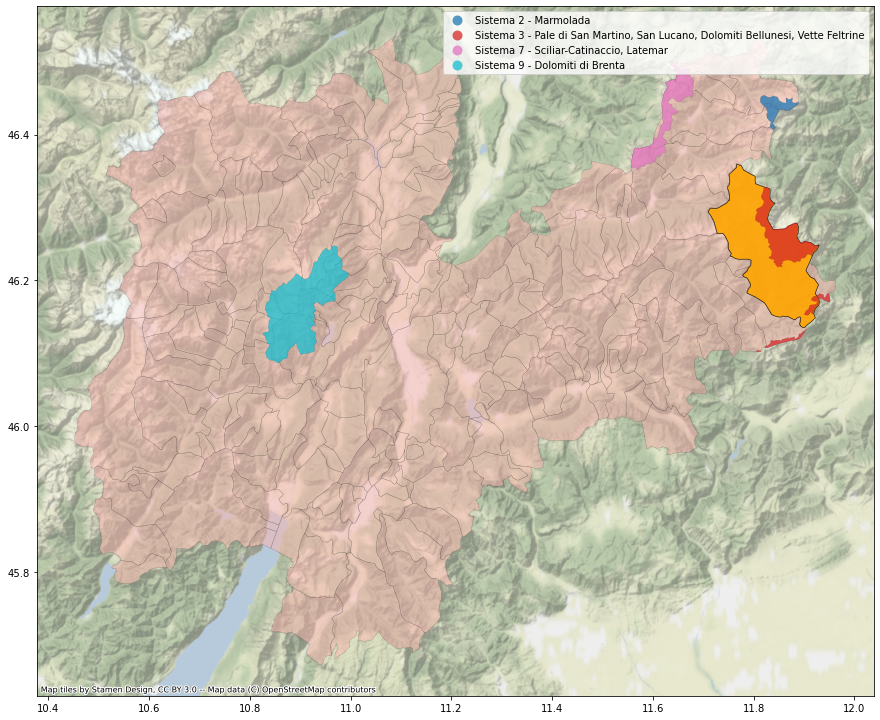

In [78]:
base = municipalities_TN.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_TN.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

primiero.to_crs(epsg=4326).plot(
    figsize=(15,15),
    color="orange",
    edgecolor="k",
    lw=0.6,
    alpha=0.9,
    ax=base
    )

dolomities_TN_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.75,
    lw=0.1,
    )

**Primiero San Martino di Castrozza** is the municipality with the highest area of Domolimiti in the province of Trento.
Let's check if areas and percentage of the municipalities sum up to that of the province of Trento:

In [79]:
round(dolomiti_TN_area, 4) == round(sum(sorted_df.Dolomiti_area), 4)

False

In [80]:
round(persentage_dolomiti_TN, 4) == round(sum(sorted_df.percentage_over_total_Dolimiti_area), 4)

True

### Province of Bolzano

Province of Bolzano is the other procince of Trentino-Alto Adige, which represents the region with the largest area of Dolomiti mountains.

In [81]:
province_BZ = provinces[provinces.DEN_PROV == 'Bolzano']
province_BZ

,COD_REG,COD_PROV,DEN_PROV,Shape_Area,geometry
20,4,21,Bolzano,7.399378e+09,"POLYGON ((12.20511 47.08653, 12.20668 47.08627..."


<AxesSubplot:>

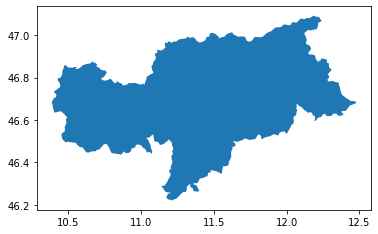

In [82]:
province_BZ.plot()

Extract Dolomiti systems of province of Bolzano:


In [83]:
dolomities_BZ = geodf_dolomities_provices[geodf_dolomities_provices.DEN_PROV == 'Bolzano']
dolomities_BZ

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
4,Sistema 5 - Dolomiti settentrionali,Esplora il Sistema 5 Dolomiti settentrionali s...,"MULTIPOLYGON Z (((12.16274 46.57915 0.00000, 1...",5.360157e+08,4,21,Bolzano,7.399378e+09,Trentino-Alto Adige,1.360755e+10
5,Sistema 6 - Puez-Odle,Esplora il Sistema 6 Puez-Odle su<br>http://ww...,"POLYGON Z ((11.83423 46.66379 0.00000, 11.8333...",7.930332e+07,4,21,Bolzano,7.399378e+09,Trentino-Alto Adige,1.360755e+10
6,"Sistema 7 - Sciliar-Catinaccio, Latemar","Esplora il Sistema 7 Sciliar-Catinaccio, Latem...","POLYGON Z ((11.51976 46.48659 0.00000, 11.5202...",9.302092e+07,4,21,Bolzano,7.399378e+09,Trentino-Alto Adige,1.360755e+10
7,Sistema 8 - Bletterbach,Esplora il Sistema 8 Bletterbach su<br>http://...,"POLYGON Z ((11.41907 46.36664 0.00000, 11.4190...",2.716007e+06,4,21,Bolzano,7.399378e+09,Trentino-Alto Adige,1.360755e+10


<AxesSubplot:>

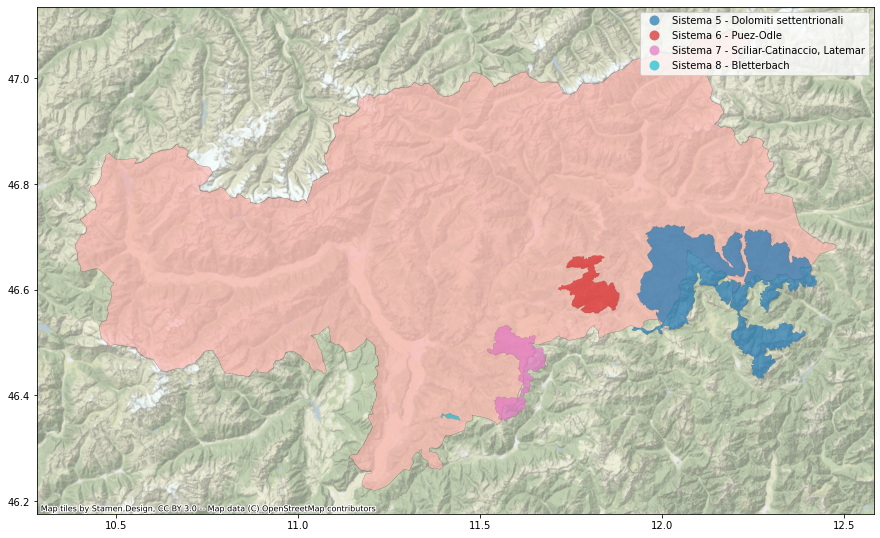

In [84]:
base = province_BZ.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_BZ.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_BZ.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

#### Clip the Dolomiti systems geometry in order to have only the territory inside the province boudaries


In [85]:
dolomities_BZ_clipped = dolomities_BZ.clip(province_BZ)

<AxesSubplot:>

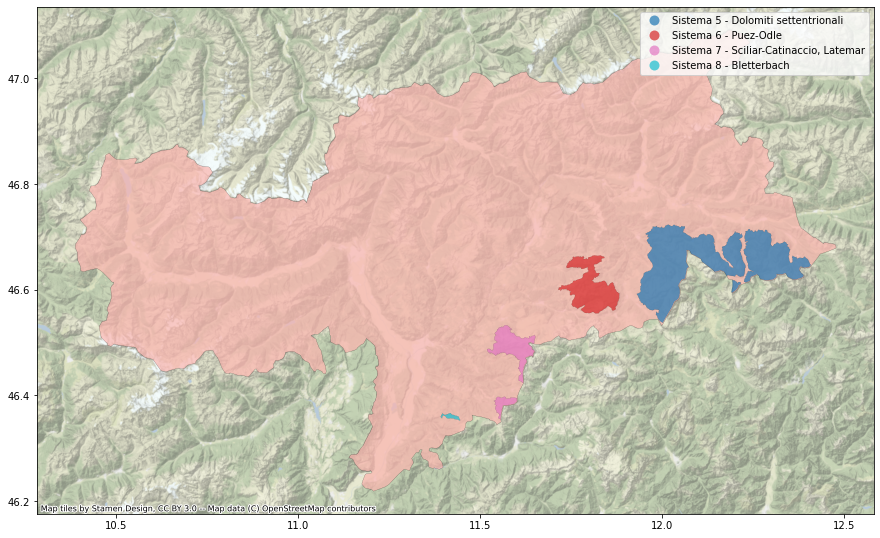

In [86]:
base = province_BZ.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_BZ.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_BZ_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

#### Recalculate clipped Dolomiti's territory area

In [87]:
dolomities_BZ_clipped_areas = dolomities_BZ_clipped.to_crs(epsg=32632)
dolomities_BZ_clipped_areas["area"] = dolomities_BZ_clipped_areas['geometry'].area 
dolomities_BZ_clipped_areas

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
7,Sistema 8 - Bletterbach,Esplora il Sistema 8 Bletterbach su<br>http://...,"POLYGON ((686070.959 5137628.513, 686071.420 5...",2.716007e+06,4,21,Bolzano,7.399378e+09,Trentino-Alto Adige,1.360755e+10
6,"Sistema 7 - Sciliar-Catinaccio, Latemar","Esplora il Sistema 7 Sciliar-Catinaccio, Latem...","MULTIPOLYGON (((701176.461 5144473.670, 701115...",5.403707e+07,4,21,Bolzano,7.399378e+09,Trentino-Alto Adige,1.360755e+10
4,Sistema 5 - Dolomiti settentrionali,Esplora il Sistema 5 Dolomiti settentrionali s...,"MULTIPOLYGON (((747258.034 5167424.443, 747224...",3.031830e+08,4,21,Bolzano,7.399378e+09,Trentino-Alto Adige,1.360755e+10
5,Sistema 6 - Puez-Odle,Esplora il Sistema 6 Puez-Odle su<br>http://ww...,"POLYGON ((716892.208 5171663.164, 716967.716 5...",7.930332e+07,4,21,Bolzano,7.399378e+09,Trentino-Alto Adige,1.360755e+10


Sum the Dolomiti's areas in province of Bolzano:


In [88]:
dolomiti_BZ_area = sum(dolomities_BZ_clipped_areas.area)
print(round(dolomiti_BZ_area/10**6, 2), " km\u00b2 of Dolomiti are in province of Bolzano", sep="")


439.24 km² of Dolomiti are in province of Bolzano


The province of Bolzano seems to include much more Dolomiti's territory than the province of Trento.

With the overlay difference prlot it is possible to notice the higher impact on the province's territory:

<AxesSubplot:>

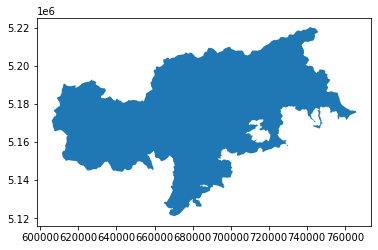

In [89]:
dolomiti_BZ_overlay = province_BZ.to_crs(epsg=32632).overlay(dolomities_BZ_clipped.to_crs(epsg=32632), how="difference")
base = province_BZ.to_crs(epsg=4326).plot(
    figsize=(15,15),
    color= "white",
    edgecolor="k",
    lw=0.7,
    alpha=0.7
    )
dolomiti_BZ_overlay.to_crs(epsg=4326).plot(ax=base)

#### Proportion of Dolomiti's territory in province of Bolzano


In [90]:
dolomiti_BZ_area = sum(dolomities_BZ_clipped_areas.area)
overal_dolomiti_area = sum(geodf_dolomities['area'])

In [91]:
persentage_dolomiti_BZ = (dolomiti_BZ_area/overal_dolomiti_area)*100

print("Province of Trento contains the ", round(persentage_dolomiti_BZ, 2), "% of the Dolomiti's terriotory", sep="")


Province of Trento contains the 30.96% of the Dolomiti's terriotory


As previously assumed, the province contains twice as much Dolomiti's peaks as the previous one.

#### Proportion of each Dolomiti system in province of Trento

We can use the previous defined function:


In [92]:
for index, row in dolomities_BZ.iterrows():
    province_systems_percentage(row.DEN_PROV, row.Name)

56.56% of the 'Sistema 5 - Dolomiti settentrionali' is in province of Bolzano
100.0% of the 'Sistema 6 - Puez-Odle' is in province of Bolzano
58.09% of the 'Sistema 7 - Sciliar-Catinaccio, Latemar' is in province of Bolzano
100.0% of the 'Sistema 8 - Bletterbach' is in province of Bolzano


The province contains two systems in its totality and more than half of two other systems. Province of Bolzano wins over province of Trento.

### Dolomiti's municipalities of province of Bolzano

Get municipalities of province of Bolzano:


In [93]:
code_BZ = province_BZ.COD_PROV.values[0]
code_BZ

21

In [94]:
municipalities_BZ = municipalities[municipalities.COD_PROV == code_BZ]
municipalities_BZ.head(4)

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
2755,4,21,021001,Aldino,6.276794e+07,"POLYGON ((11.33993 46.40130, 11.35272 46.39816..."
2756,4,21,021002,Andriano,5.290305e+06,"POLYGON ((11.24288 46.52772, 11.24392 46.52792..."
2757,4,21,021003,Anterivo,1.117156e+07,"POLYGON ((11.34675 46.29452, 11.35893 46.29612..."
2758,4,21,021004,Appiano sulla strada del vino,5.817631e+07,"POLYGON ((11.20784 46.52054, 11.21153 46.52043..."


<AxesSubplot:>

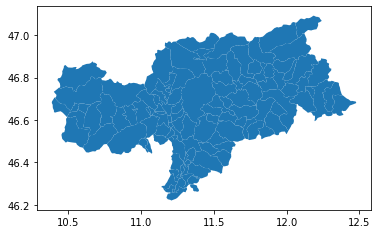

In [95]:
municipalities_BZ.plot()

#### Get municipalities that contain Dolomiti's territory

In [96]:
geo_dolomiti_BZ_mun = municipalities_BZ[municipalities_BZ.COMUNE.isin(dolomiti_mun)]

print("Municipalities in province of Bolzano that contain Dolomiti: ")
for i in geo_dolomiti_BZ_mun.COMUNE.unique():
    print("-", i, end="\n")

Municipalities in province of Bolzano that contain Dolomiti: 
- Aldino
- Badia
- Braies
- Castelrotto
- Corvara in Badia
- Dobbiaco
- FiÃ¨ allo Sciliar
- Funes
- Marebbe
- Nova Levante
- Nova Ponente
- Ortisei
- San Candido
- San Martino in Badia
- Santa Cristina Valgardena
- Selva di Val Gardena
- Sesto
- Tires
- Valdaora
- La Valle


<AxesSubplot:>

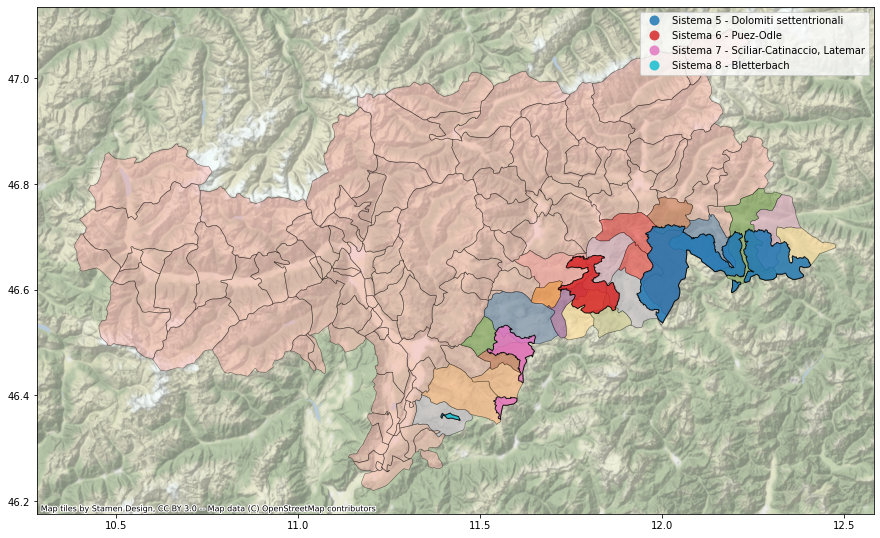

In [97]:
base = municipalities_BZ.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.6,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_BZ.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

geo_dolomiti_BZ_mun.to_crs(epsg=4326).plot(
    column='COMUNE',
    figsize=(15,15),
    cmap="Paired",
    edgecolor="k",
    lw=0.2,
    alpha=0.4,
    ax=base
    )

dolomities_BZ_clipped.to_crs(epsg=4326).plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.85,
    lw=1,
    )

#### Which is the municiplaity that contains the highest area of Dolomiti?

We use the previous defined function to calculate municipalities Dolomiti's areas and percentage on the overall Dolomiti's terriotry.

In [98]:
list_mun_BZ = []
list_area_BZ = []
list_percentage_BZ = []

for index, row in geo_dolomiti_BZ_mun.iterrows():
    temp = mun_systems_area(row.COMUNE)

    list_mun_BZ.append(temp[0])
    list_area_BZ.append(temp[1])
    list_percentage_BZ.append(temp[2])


'Aldino' contains 2.716 km² of Dolomities.and the 0.1914% of the overall Dolomities territory
'Badia' contains 22.984 km² of Dolomities.and the 1.62% of the overall Dolomities territory
'Braies' contains 54.775 km² of Dolomities.and the 3.8606% of the overall Dolomities territory
'Castelrotto' contains 9.882 km² of Dolomities.and the 0.6965% of the overall Dolomities territory
'Corvara in Badia' contains 5.279 km² of Dolomities.and the 0.372% of the overall Dolomities territory
'Dobbiaco' contains 59.918 km² of Dolomities.and the 4.2231% of the overall Dolomities territory
'FiÃ¨ allo Sciliar' contains 10.91 km² of Dolomities.and the 0.7689% of the overall Dolomities territory
'Funes' contains 15.7 km² of Dolomities.and the 1.1066% of the overall Dolomities territory
'Marebbe' contains 102.101 km² of Dolomities.and the 7.1963% of the overall Dolomities territory
'Nova Levante' contains 6.319 km² of Dolomities.and the 0.4454% of the overall Dolomities territory
'Nova Ponente' contains 4.

In [99]:
df_mun_BZ = pd.DataFrame(list(zip(list_mun_BZ, list_area_BZ, list_percentage_BZ)),
               columns =['municipality', 'Dolomiti_area', 'percentage_over_total_Dolimiti_area'])

sorted_df_BZ = df_mun_BZ.sort_values(by=['Dolomiti_area'], ascending=False)
sorted_df_BZ.head(5)

,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area
8,Marebbe,1.021015e+08,7.196300
5,Dobbiaco,5.991817e+07,4.223144
2,Braies,5.477485e+07,3.860633
16,Sesto,2.970603e+07,2.093736
12,San Candido,2.848610e+07,2.007753


In [100]:
sorted_df_BZ["province"] = 'Bolzano'

Some municipalities have quite high percentages being only individual municipalities.

Let's add the municipalities to the overall municipalities rankig list:

In [101]:
dolomiti_municipality_rank = sorted_df.append(pd.DataFrame(data = sorted_df_BZ), ignore_index=True)
dolomiti_municipality_rank = dolomiti_municipality_rank.sort_values(by=['Dolomiti_area'], ascending=False)
dolomiti_municipality_rank.head(5)

,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area,province
22,Marebbe,1.021015e+08,7.196300,Bolzano
23,Dobbiaco,5.991817e+07,4.223144,Bolzano
24,Braies,5.477485e+07,3.860633,Bolzano
0,Primiero San Martino di Castrozza,4.132196e+07,2.912448,Trento
1,San Lorenzo Dorsino,3.670043e+07,2.586715,Trento


The podium is now entirely composed by municipalities in the province of Bolzano.

#### Which is the municipality with the highest area of Domolimiti in the province of Bolzano?

In [102]:
highest_dolomiti_area_mun = dolomiti_municipality_rank[dolomiti_municipality_rank.Dolomiti_area == dolomiti_municipality_rank.Dolomiti_area.max()]
marebbe = municipalities[municipalities.COMUNE == highest_dolomiti_area_mun.municipality.values[0]]
marebbe

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
2801,4,21,021047,Marebbe,1.589979e+08,"POLYGON ((11.94437 46.74552, 11.95893 46.73875..."


<AxesSubplot:>

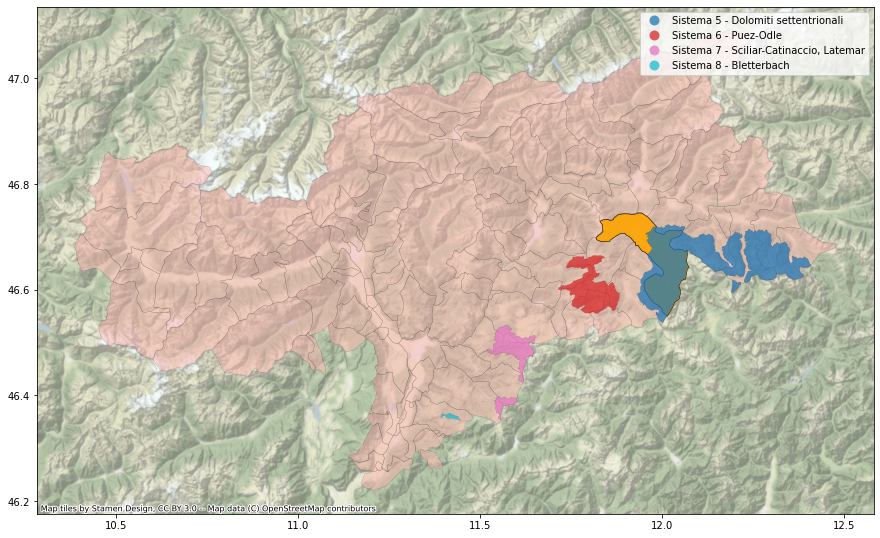

In [103]:
base = municipalities_BZ.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_BZ.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

marebbe.to_crs(epsg=4326).plot(
    figsize=(15,15),
    color="orange",
    edgecolor="k",
    lw=0.6,
    alpha=0.9,
    ax=base
    )

dolomities_BZ_clipped.to_crs(epsg=4326).plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.75,
    lw=0.1,
    )

**Marebbe** is the municipality with the highest area of Domolimiti in the province of Bolzano.
Let's check if areas and percentage of the municipalities sum up to that of the province:


In [104]:
round(dolomiti_BZ_area, 4) == round(sum(sorted_df_BZ.Dolomiti_area), 2)

False

In [105]:
round(persentage_dolomiti_BZ, 4) == round(sum(sorted_df_BZ.percentage_over_total_Dolimiti_area), 2)


True

### Province of Belluno

Province of Belluno is the only province in Veneto that contains portion of Dolomiti's territory. Nevertheless, this province makes Veneto the second region for Dolomite area.


In [106]:
province_BL = provinces[provinces.DEN_PROV == 'Belluno']
province_BL

,COD_REG,COD_PROV,DEN_PROV,Shape_Area,geometry
24,5,25,Belluno,3.609841e+09,"POLYGON ((12.50591 46.67839, 12.50603 46.67803..."


<AxesSubplot:>

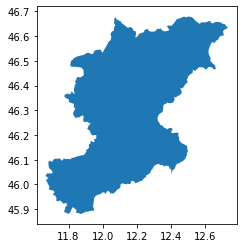

In [107]:
province_BL.plot()

#### Extract Dolomiti systems of province of Belluno

In [108]:
dolomities_BL = geodf_dolomities_provices[geodf_dolomities_provices.DEN_PROV == 'Belluno']
dolomities_BL

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
0,"Sistema 1 - Pelmo, Croda da Lago","Esplora il Sistema 1 Pelmo, Croda da Lago su<b...","POLYGON Z ((12.12142 46.40488 0.00000, 12.1214...",4.315303e+07,5,25,Belluno,3.609841e+09,Veneto,1.834355e+10
1,Sistema 2 - Marmolada,Esplora il Sistema 2 Marmolada su<br>http://ww...,"POLYGON Z ((11.82319 46.45296 0.00000, 11.8221...",2.205786e+07,5,25,Belluno,3.609841e+09,Veneto,1.834355e+10
2,"Sistema 3 - Pale di San Martino, San Lucano, D...","Esplora il Sistema 3 Pale di San Martino, San ...","POLYGON Z ((11.98683 46.31720 0.00000, 11.9880...",3.165677e+08,5,25,Belluno,3.609841e+09,Veneto,1.834355e+10
3,Sistema 4 - Dolomiti friulane e d'Oltre Piave,Esplora il Sistema 4 Dolomiti friulane e d'Olt...,"POLYGON Z ((12.51205 46.42487 0.00000, 12.5120...",2.146157e+08,5,25,Belluno,3.609841e+09,Veneto,1.834355e+10
4,Sistema 5 - Dolomiti settentrionali,Esplora il Sistema 5 Dolomiti settentrionali s...,"MULTIPOLYGON Z (((12.16274 46.57915 0.00000, 1...",5.360157e+08,5,25,Belluno,3.609841e+09,Veneto,1.834355e+10


In [109]:
print(province_BL.DEN_PROV.values[0], ' contains ', len(dolomities_BL.Name.unique()), " Dolomiti systems:", sep="")
for i in dolomities_BL.Name.unique():
    print("-", i, end="\n")

Belluno contains 5 Dolomiti systems:
- Sistema 1 - Pelmo, Croda da Lago
- Sistema 2 - Marmolada
- Sistema 3 - Pale di San Martino, San Lucano, Dolomiti Bellunesi, Vette Feltrine
- Sistema 4 - Dolomiti friulane e d'Oltre Piave
- Sistema 5 - Dolomiti settentrionali


<AxesSubplot:>

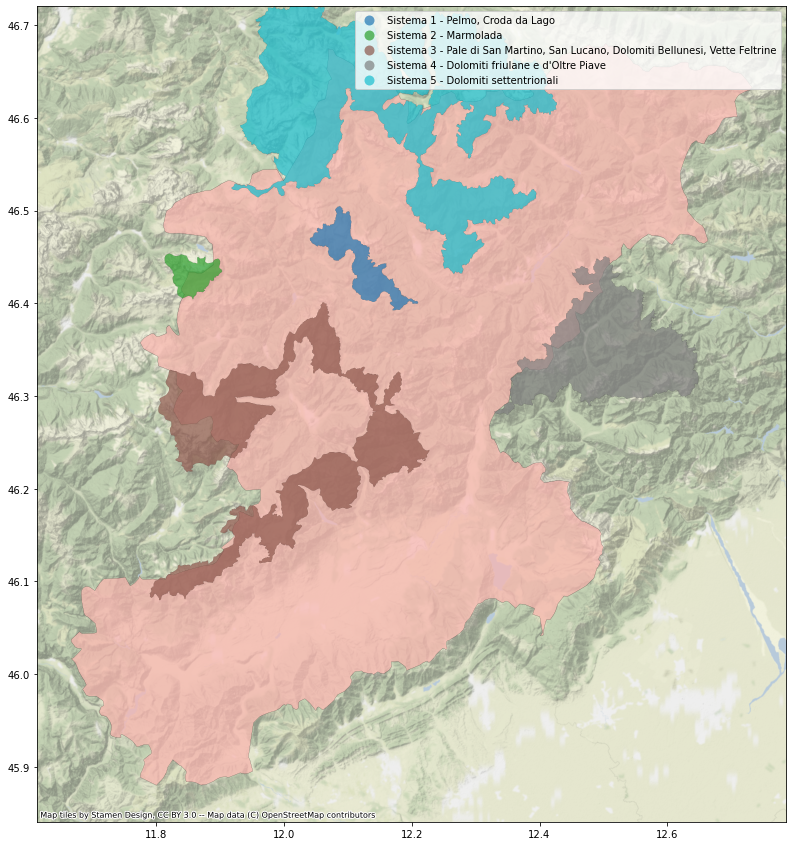

In [110]:
base = province_BL.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_BL.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_BL.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

#### Clip the Dolomiti systems geometry in order to have only the territory inside the province boudaries


In [111]:
dolomities_BL_clipped = dolomities_BL.clip(province_BL)

<AxesSubplot:>

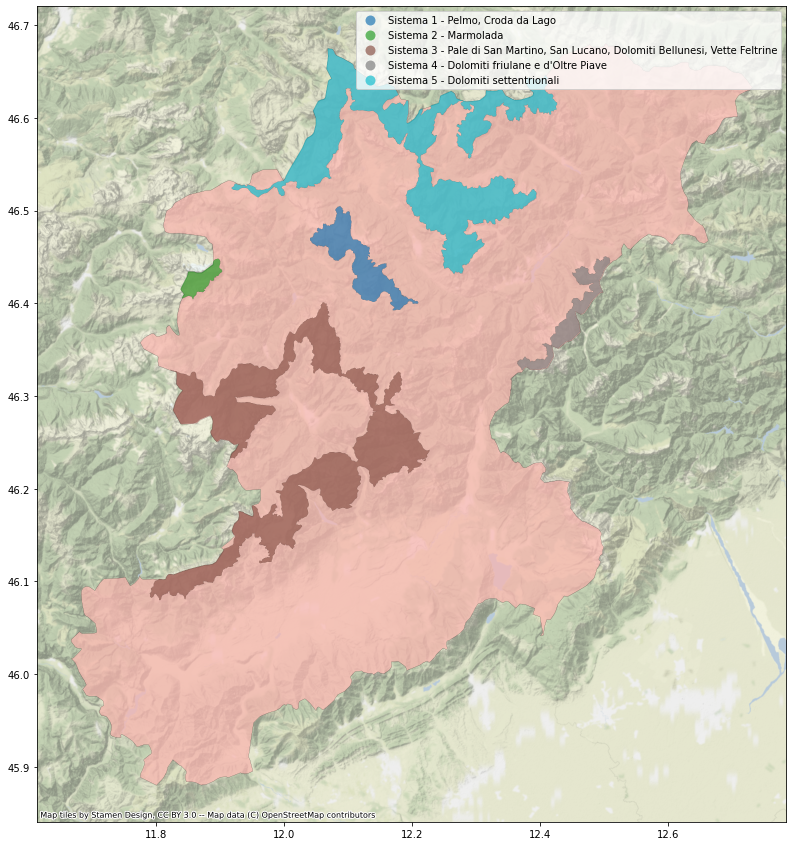

In [112]:
base = province_BL.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_BL.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_BL_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )


#### Recalculate clipped Dolomiti's territory area

In [113]:
dolomities_BL_clipped_areas= dolomities_BL_clipped.to_crs(epsg=32632)
dolomities_BL_clipped_areas["area"] = dolomities_BL_clipped_areas['geometry'].area

Sum the Dolomiti's areas in province of Belluno:

In [114]:
dolomiti_BL_area = sum(dolomities_BL_clipped_areas.area)
print(round(dolomiti_BL_area/10**6, 2), " km\u00b2 of Dolomiti are in province of Trento", sep="")

584.6 km² of Dolomiti are in province of Trento


<AxesSubplot:>

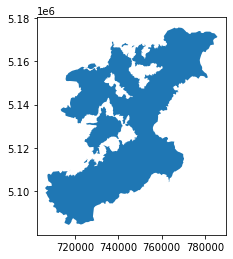

In [115]:
dolomiti_BL_overlay = province_BL.to_crs(epsg=32632).overlay(dolomities_BL_clipped.to_crs(epsg=32632), how="difference")
base = province_BL.to_crs(epsg=4326).plot(
    figsize=(15,15),
    color= "white",
    edgecolor="k",
    lw=0.7,
    alpha=0.7
    )
dolomiti_BL_overlay.to_crs(epsg=4326).plot(ax=base)

We can see much more impact on the province territory with respect to the previous provinces.

#### Proportion of Dolomiti's territory in province of Belluno


In [116]:
dolomiti_BL_area = sum(dolomities_BL_clipped_areas.area)
overal_dolomiti_area = sum(geodf_dolomities['area'])

In [117]:
persentage_dolomiti_BL = (dolomiti_BL_area/overal_dolomiti_area)*100

print("Province of Belluno contains the ", round(persentage_dolomiti_BL, 2), "% of the Dolomiti's terriotory", sep="")

Province of Belluno contains the 41.2% of the Dolomiti's terriotory


The province of Belluno contains 10% more Dolomiti's territory than Bolzano.

#### What proportion of each system does the province contain?


In [118]:
for index, row in dolomities_BL.iterrows():
    province_systems_percentage(row.DEN_PROV, row.Name)

100.0% of the 'Sistema 1 - Pelmo, Croda da Lago' is in province of Belluno
47.92% of the 'Sistema 2 - Marmolada' is in province of Belluno
85.53% of the 'Sistema 3 - Pale di San Martino, San Lucano, Dolomiti Bellunesi, Vette Feltrine' is in province of Belluno
12.71% of the 'Sistema 4 - Dolomiti friulane e d'Oltre Piave' is in province of Belluno
43.44% of the 'Sistema 5 - Dolomiti settentrionali' is in province of Belluno


Province of Belluno contain the entire *Sistema 1*, higher percentages of *Sistema 3*, half of *Sistema 2* and portions of *Sistemna 5* and *Sistema 4*.

### Dolomiti's municipalities of province of Belluno

In [119]:
code_BL = province_BL.COD_PROV.values[0]
code_BL

25

In [120]:
municipalities_BL = municipalities[municipalities.COD_PROV == code_BL]
municipalities_BL.head(4)

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
3249,5,25,025001,Agordo,2.411324e+07,"POLYGON ((12.06082 46.33488, 12.07344 46.33107..."
3250,5,25,025002,Alano di Piave,3.648229e+07,"POLYGON ((11.89820 45.93666, 11.90215 45.93687..."
3251,5,25,025003,Alleghe,2.956926e+07,"POLYGON ((11.99511 46.44236, 12.00606 46.43859..."
3252,5,25,025004,ArsiÃ¨,6.469551e+07,"POLYGON ((11.73171 46.01990, 11.73636 46.02037..."


<AxesSubplot:>

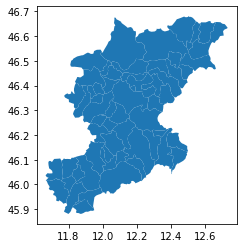

In [121]:
municipalities_BL.plot()

#### Get municipalities that contain Dolomiti's territory

In [122]:
geo_dolomiti_BL_mun = municipalities_BL[municipalities_BL.COMUNE.isin(dolomiti_mun)]

print("Municipalities in province of Trento that contain Dolomiti: ")
for i in geo_dolomiti_BL_mun.COMUNE.unique():
    print("-", i, end="\n")

Municipalities in province of Trento that contain Dolomiti: 
- Agordo
- Alleghe
- Auronzo di Cadore
- Belluno
- Borca di Cadore
- Calalzo di Cadore
- Cencenighe Agordino
- Cesiomaggiore
- Colle Santa Lucia
- Comelico Superiore
- Cortina d'Ampezzo
- Domegge di Cadore
- Falcade
- Feltre
- Canale d'Agordo
- Gosaldo
- La Valle Agordina
- Livinallongo del Col di Lana
- Lorenzago di Cadore
- Lozzo di Cadore
- Ospitale di Cadore
- Perarolo di Cadore
- Pieve di Cadore
- Rivamonte Agordino
- Rocca Pietore
- San Gregorio nelle Alpi
- Santa Giustina
- San Tomaso Agordino
- San Vito di Cadore
- Sedico
- Selva di Cadore
- Sospirolo
- Sovramonte
- Taibon Agordino
- Vodo Cadore
- Voltago Agordino
- ZoppÃ¨ di Cadore
- Longarone
- Val di Zoldo


We have a lot of involed municipalities here.

<AxesSubplot:>

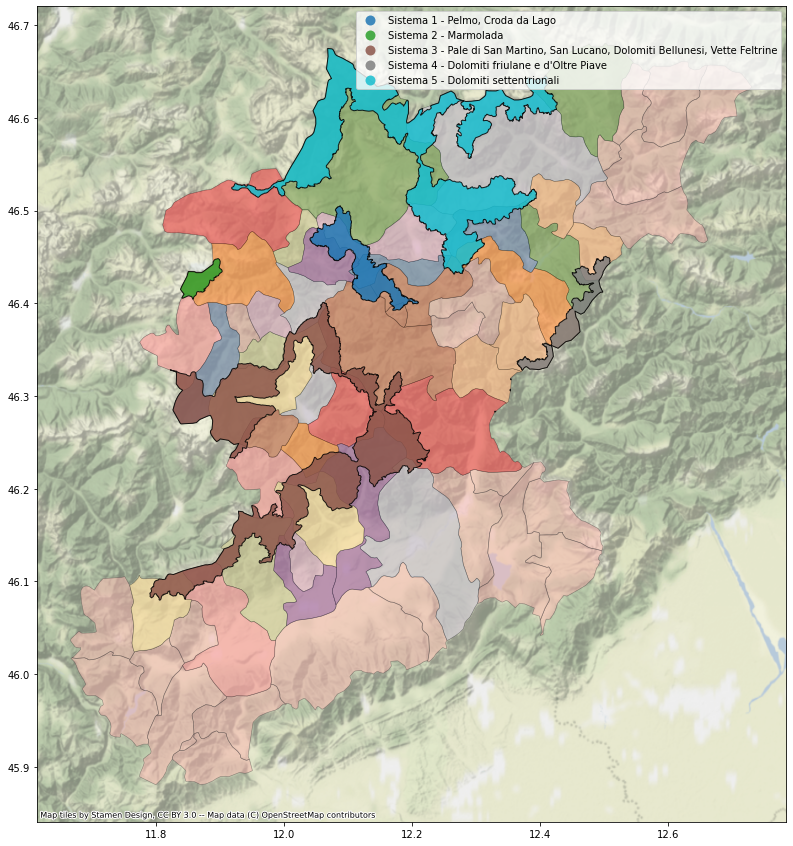

In [123]:
base = municipalities_BL.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="#413A3B",
    lw=0.6,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_BL.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

geo_dolomiti_BL_mun.to_crs(epsg=4326).plot(
    column='COMUNE',
    figsize=(15,15),
    cmap="Paired",
    edgecolor="k",
    lw=0.2,
    alpha=0.4,
    ax=base
    )

dolomities_BL_clipped.to_crs(epsg=4326).plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.85,
    lw=1,
    )

Municipalities that include Dolomiti's territory also appear to be the majority of municipalities in the province of Belluno.

#### Which is the municiplaity that contains the highest area of Dolomiti?


In [124]:
list_mun_BL = []
list_area_BL = []
list_percentage_BL = []

for index, row in geo_dolomiti_BL_mun.iterrows():
    temp = mun_systems_area(row.COMUNE)

    list_mun_BL.append(temp[0])
    list_area_BL.append(temp[1])
    list_percentage_BL.append(temp[2])

'Agordo' contains 2.783 km² of Dolomities.and the 0.1962% of the overall Dolomities territory
'Alleghe' contains 3.146 km² of Dolomities.and the 0.2217% of the overall Dolomities territory
'Auronzo di Cadore' contains 79.371 km² of Dolomities.and the 5.5942% of the overall Dolomities territory
'Belluno' contains 2.71 km² of Dolomities.and the 0.191% of the overall Dolomities territory
'Borca di Cadore' contains 9.347 km² of Dolomities.and the 0.6588% of the overall Dolomities territory
'Calalzo di Cadore' contains 18.463 km² of Dolomities.and the 1.3013% of the overall Dolomities territory
'Cencenighe Agordino' contains 1.683 km² of Dolomities.and the 0.1186% of the overall Dolomities territory
'Cesiomaggiore' contains 26.679 km² of Dolomities.and the 1.8804% of the overall Dolomities territory
'Colle Santa Lucia' contains 0.008 km² of Dolomities.and the 0.0006% of the overall Dolomities territory
'Comelico Superiore' contains 6.373 km² of Dolomities.and the 0.4492% of the overall Dolo

In [125]:
df_mun_BL = pd.DataFrame(list(zip(list_mun_BL, list_area_BL, list_percentage_BL)),
               columns =['municipality', 'Dolomiti_area', 'percentage_over_total_Dolimiti_area'])

sorted_df_BL = df_mun_BL.sort_values(by=['Dolomiti_area'], ascending=False)
sorted_df_BL.head(5)

,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area
10,Cortina d'Ampezzo,1.053706e+08,7.426714
2,Auronzo di Cadore,7.937064e+07,5.594190
33,Taibon Agordino,6.198461e+07,4.368790
29,Sedico,4.287910e+07,3.022198
7,Cesiomaggiore,2.667912e+07,1.880394


As in the province of Bolzano, we still have high percentages for individual municipalities.

In [126]:
highest_dolomiti_area_mun = sorted_df_BL[sorted_df_BL.Dolomiti_area == sorted_df_BL.Dolomiti_area.max()]
cortina = municipalities[municipalities.COMUNE == highest_dolomiti_area_mun.municipality.values[0]]
cortina

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
3263,5,25,025016,Cortina d'Ampezzo,2.534631e+08,"POLYGON ((12.07025 46.67491, 12.07473 46.67458..."


<AxesSubplot:>

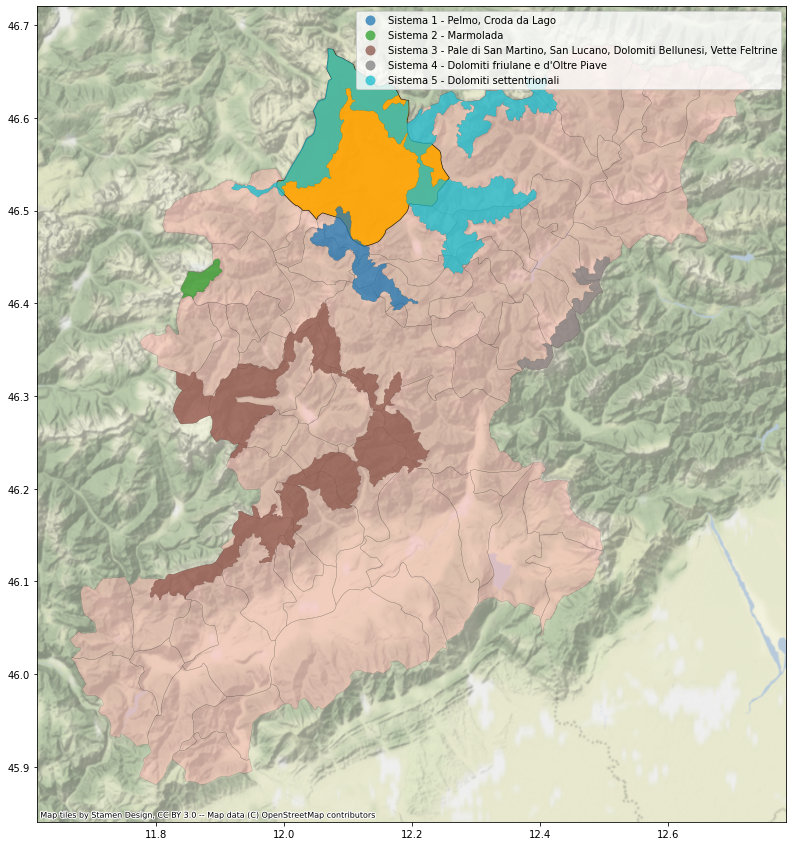

In [127]:
base = municipalities_BL.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_BL.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

cortina.to_crs(epsg=4326).plot(
    figsize=(15,15),
    color="orange",
    edgecolor="k",
    lw=0.6,
    alpha=0.9,
    ax=base
    )

dolomities_BL_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.75,
    lw=0.1,
    )

**Cortina d'Ampezzo** is the municipality with the highest area of Domolomiti in the province of Belluno.
Let's check if areas and percentage of the municipalities sum up to that of the province:


In [128]:
round(dolomiti_BL_area, 4) == round(sum(sorted_df_BL.Dolomiti_area), 4)


False

In [129]:
round(persentage_dolomiti_BL, 4) == round(sum(sorted_df_BL.percentage_over_total_Dolimiti_area), 4)

True

Is Cortina d'Ampezzo also highest than Marebbe and the other municipalities? Let's reformulate the ranking list.

In [130]:
sorted_df_BL["province"] = 'Belluno'

In [131]:
dolomiti_municipality_rank = dolomiti_municipality_rank.append(pd.DataFrame(data = sorted_df_BL), ignore_index=True)
dolomiti_municipality_rank = dolomiti_municipality_rank.sort_values(by=['Dolomiti_area'], ascending=False)
dolomiti_municipality_rank.head(5)

,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area,province
42,Cortina d'Ampezzo,1.053706e+08,7.426714,Belluno
0,Marebbe,1.021015e+08,7.196300,Bolzano
43,Auronzo di Cadore,7.937064e+07,5.594190,Belluno
44,Taibon Agordino,6.198461e+07,4.368790,Belluno
1,Dobbiaco,5.991817e+07,4.223144,Bolzano


Yes, it is. Now the podium is mainly composed of municipalities in the province of Bellluno. 

### Province of Pordenone

Province of Pordenone is in Friuli Venezia Giulia, and together with province of Udine made this region the last Dolomiti's region.

In [132]:
province_PN = provinces[provinces.DEN_PROV == 'Pordenone']
province_PN

,COD_REG,COD_PROV,DEN_PROV,Shape_Area,geometry
92,6,93,Pordenone,2.275459e+09,"POLYGON ((12.52110 46.38899, 12.52360 46.38049..."


<AxesSubplot:>

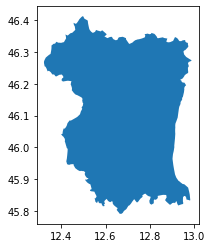

In [133]:
province_PN.plot()

Extract Dolomiti systems of province of Pordenone:

In [134]:
dolomities_PN = geodf_dolomities_provices[geodf_dolomities_provices.DEN_PROV == 'Pordenone']
dolomities_PN

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
3,Sistema 4 - Dolomiti friulane e d'Oltre Piave,Esplora il Sistema 4 Dolomiti friulane e d'Olt...,"POLYGON Z ((12.51205 46.42487 0.00000, 12.5120...",2.146157e+08,6,93,Pordenone,2.275459e+09,Friuli Venezia Giulia,7.933911e+09


In [135]:
print(province_PN.DEN_PROV.values[0], ' contains ', len(dolomities_PN.Name.unique()), " Dolomiti systems:", sep="")
for i in dolomities_PN.Name.unique():
    print("-", i, end="\n")

Pordenone contains 1 Dolomiti systems:
- Sistema 4 - Dolomiti friulane e d'Oltre Piave


<AxesSubplot:>

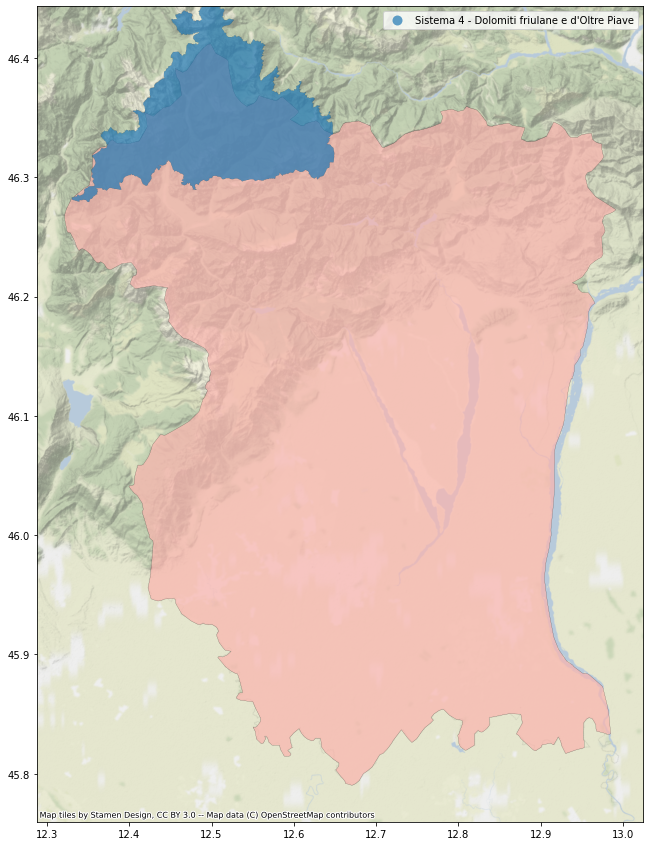

In [136]:
base = province_PN.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_PN.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_PN.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

As we seen the only system in Friuli Venezia Giulia is *Sistema 4 - Dolomiti friulane e d'Oltre Piave*

#### Clip the Dolomiti systems geometry in order to have only the territory inside the province boudaries


In [137]:
dolomities_PN_clipped = dolomities_PN.clip(province_PN)

<AxesSubplot:>

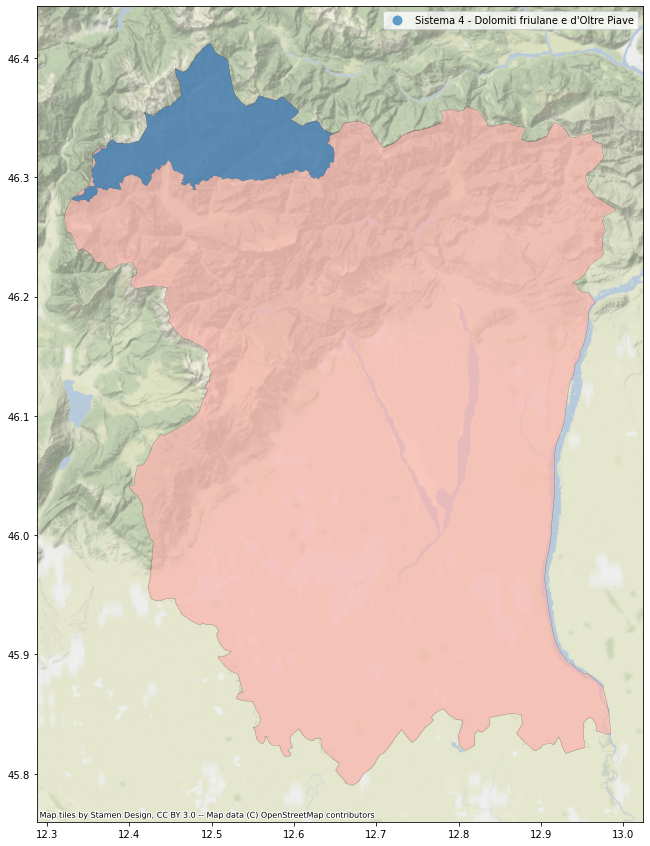

In [138]:
base = province_PN.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_PN.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_PN_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

#### Recalculate clipped Dolomiti's territory area

In [139]:
dolomities_PN_clipped_areas = dolomities_PN_clipped.to_crs(epsg=32632)
dolomities_PN_clipped_areas["area"] = dolomities_PN_clipped_areas['geometry'].area
dolomities_PN_clipped_areas

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
3,Sistema 4 - Dolomiti friulane e d'Oltre Piave,Esplora il Sistema 4 Dolomiti friulane e d'Olt...,"POLYGON ((762929.905 5139138.528, 762933.346 5...",1.519279e+08,6,93,Pordenone,2.275459e+09,Friuli Venezia Giulia,7.933911e+09


Sum the Dolomiti's areas in province of Pordenone:

In [140]:
dolomiti_PN_area = sum(dolomities_PN_clipped_areas.area)
print(round(dolomiti_PN_area/10**6, 2), " km\u00b2 of Dolomiti are in province of Pordenone", sep="")


151.93 km² of Dolomiti are in province of Pordenone


Since Friuli Venezia Giulia contains a low percentage of Dolomiti's territory, also province of Pordenone contains only a small area.

#### Proportion of Dolomiti's territory in province of Pordenone


In [141]:
dolomiti_PN_area = sum(dolomities_PN_clipped_areas.area)
overal_dolomiti_area = sum(geodf_dolomities['area'])

In [142]:
persentage_dolomiti_PN = (dolomiti_PN_area/overal_dolomiti_area)*100

print("Province of Trento contains the ", round(persentage_dolomiti_PN, 2), "% of the Dolomiti's terriotory", sep="")

Province of Trento contains the 10.71% of the Dolomiti's terriotory


the province contains 4% fewer territories than the province of Trento (14%).

#### Proportion of Dolomiti's territory in province of Pordenone


In [143]:
for index, row in dolomities_PN.iterrows():
    province_systems_percentage(row.DEN_PROV, row.Name)

70.79% of the 'Sistema 4 - Dolomiti friulane e d'Oltre Piave' is in province of Pordenone


By the way province of Pordenone contains the majority of *Sistema 4*

### Dolomiti's municipalities of province of Pordenone
#### Get municipalities of province of Pordenone


In [144]:
code_PN = province_PN.COD_PROV.values[0]
code_PN

93

In [145]:
municipalities_PN = municipalities[municipalities.COD_PROV == code_PN]
municipalities_PN.head(4)

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
7101,6,93,093001,Andreis,2.732638e+07,"POLYGON ((12.60761 46.24313, 12.61041 46.24260..."
7102,6,93,093002,Arba,1.535937e+07,"POLYGON ((12.80817 46.17472, 12.80894 46.17257..."
7103,6,93,093004,Aviano,1.137879e+08,"POLYGON ((12.57556 46.03119, 12.57536 46.03177..."
7104,6,93,093005,Azzano Decimo,5.115717e+07,"POLYGON ((12.68656 45.92821, 12.68735 45.92826..."


<AxesSubplot:>

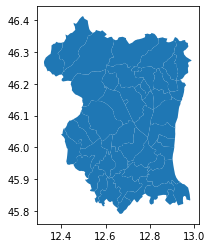

In [146]:
municipalities_PN.plot()

#### Get municipalities that contain Dolomiti's territory

In [147]:
geo_dolomiti_PN_mun = municipalities_PN[municipalities_PN.COMUNE.isin(dolomiti_mun)]

print("Municipalities in province of Pordenone that contain Dolomiti: ")
for i in geo_dolomiti_PN_mun.COMUNE.unique():
    print("-", i, end="\n")

Municipalities in province of Pordenone that contain Dolomiti: 
- Cimolais
- Claut
- Erto e Casso
- Tramonti di Sopra


As expected only few municipalities contains Dolomiti's peaks.

<AxesSubplot:>

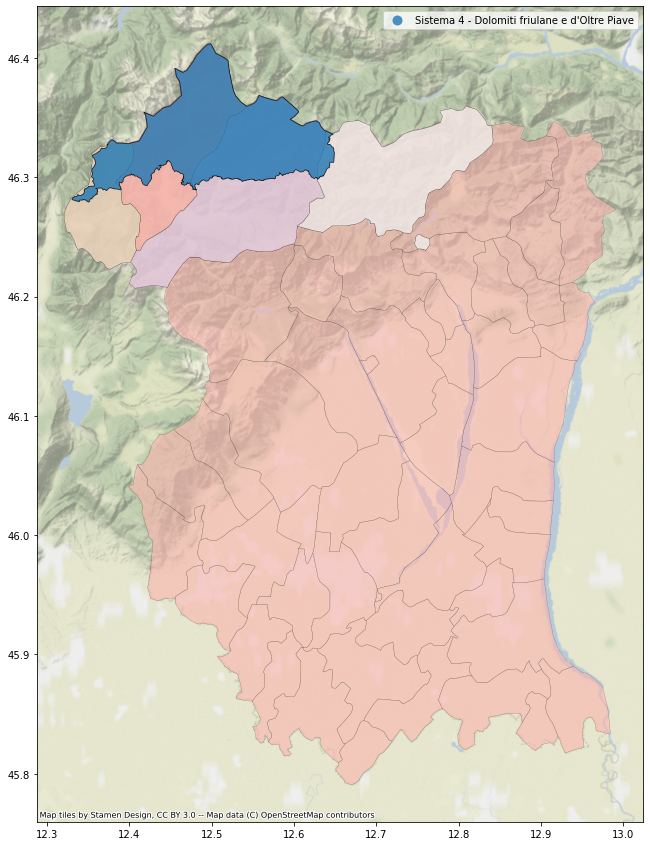

In [148]:
base = municipalities_PN.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.6)

ctx.add_basemap(base, crs=municipalities_PN.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

geo_dolomiti_PN_mun.to_crs(epsg=4326).plot(
    column='COMUNE',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7,
    ax=base
    )

dolomities_PN_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.80,
    lw=0.8,
    )

#### Which is the municiplaity that contains the highest area of Dolomiti?


In [149]:
list_mun_PN = []
list_area_PN = []
list_percentage_PN = []

for index, row in geo_dolomiti_PN_mun.iterrows():
    temp = mun_systems_area(row.COMUNE)

    list_mun_PN.append(temp[0])
    list_area_PN.append(temp[1])
    list_percentage_PN.append(temp[2])

'Cimolais' contains 70.795 km² of Dolomities.and the 4.9898% of the overall Dolomities territory
'Claut' contains 63.226 km² of Dolomities.and the 4.4563% of the overall Dolomities territory
'Erto e Casso' contains 14.635 km² of Dolomities.and the 1.0315% of the overall Dolomities territory
'Tramonti di Sopra' contains 3.272 km² of Dolomities.and the 0.2306% of the overall Dolomities territory


In [150]:
df_mun_PN = pd.DataFrame(list(zip(list_mun_PN, list_area_PN, list_percentage_PN)),
               columns =['municipality', 'Dolomiti_area', 'percentage_over_total_Dolimiti_area'])

sorted_df_PN = df_mun_PN.sort_values(by=['Dolomiti_area'], ascending=False)
sorted_df_PN

,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area
0,Cimolais,7.079494e+07,4.989759
1,Claut,6.322577e+07,4.456270
2,Erto e Casso,1.463481e+07,1.031488
3,Tramonti di Sopra,3.272357e+06,0.230642


In [151]:
highest_dolomiti_area_mun_PN = sorted_df_PN[sorted_df_PN.Dolomiti_area == sorted_df_PN.Dolomiti_area.max()]
cimolais = municipalities[municipalities.COMUNE == highest_dolomiti_area_mun_PN.municipality.values[0]]
cimolais

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
7113,6,93,093014,Cimolais,100363518.1,"POLYGON ((12.50473 46.40423, 12.50815 46.40305..."


<AxesSubplot:>

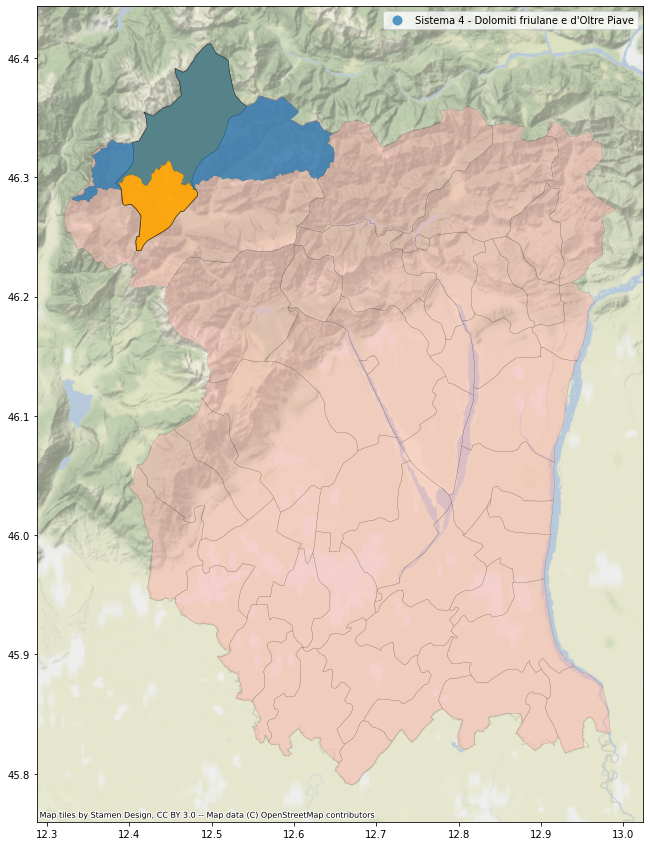

In [152]:
base = municipalities_PN.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_PN.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

cimolais.to_crs(epsg=4326).plot(
    figsize=(15,15),
    color="orange",
    edgecolor="k",
    lw=0.6,
    alpha=0.9,
    ax=base
    )

dolomities_PN_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.75,
    lw=0.1,
    )

**Cimolais** is the municipality with the highest area of Domolomiti in the province of Pordenone.
Let's check if areas and percentage of the municipalities sum up to that of the province of Trento:


In [153]:
round(dolomiti_PN_area, -1) == round(sum(sorted_df_PN.Dolomiti_area), -1)


True

In [154]:
round(persentage_dolomiti_PN, 4) == round(sum(sorted_df_PN.percentage_over_total_Dolimiti_area), 4)

True

Add Pordenone municipalities to the other Dolomiti's municipalities:


In [155]:
sorted_df_PN["province"] = 'Pordenone'
dolomiti_municipality_rank = dolomiti_municipality_rank.append(pd.DataFrame(data = sorted_df_PN), ignore_index=True)
dolomiti_municipality_rank = dolomiti_municipality_rank.sort_values(by=['Dolomiti_area'], ascending=False)
dolomiti_municipality_rank


,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area,province
0,Cortina d'Ampezzo,1.053706e+08,7.426714,Belluno
1,Marebbe,1.021015e+08,7.196300,Bolzano
2,Auronzo di Cadore,7.937064e+07,5.594190,Belluno
81,Cimolais,7.079494e+07,4.989759,Pordenone
82,Claut,6.322577e+07,4.456270,Pordenone
...,...,...,...,...
76,Imer,1.894005e+05,0.013349,Trento
77,San Tomaso Agordino,9.145406e+04,0.006446,Belluno
78,Andalo,3.618142e+04,0.002550,Trento
79,Ospitale di Cadore,1.114393e+04,0.000785,Belluno


Municipalities of province od Pordenone cannot compete with those of the provinces of Bolzano and Belluno. Nevertheless, Cimolais and Claut are fourth and fifth in the global ranking.

### Province of Udine
The province of Udine is the other Dolomiti's province of Friuli Venezia Giulia. 

In [156]:
province_UD = provinces[provinces.DEN_PROV == 'Udine']
province_UD

,COD_REG,COD_PROV,DEN_PROV,Shape_Area,geometry
29,6,30,Udine,4.969771e+09,"POLYGON ((12.76335 46.64757, 12.76549 46.64669..."


<AxesSubplot:>

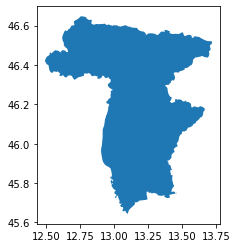

In [157]:
province_UD.plot()

Extract Dolomiti systems of province of Udine:

In [158]:
dolomities_UD = geodf_dolomities_provices[geodf_dolomities_provices.DEN_PROV == 'Udine']
dolomities_UD

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
3,Sistema 4 - Dolomiti friulane e d'Oltre Piave,Esplora il Sistema 4 Dolomiti friulane e d'Olt...,"POLYGON Z ((12.51205 46.42487 0.00000, 12.5120...",2.146157e+08,6,30,Udine,4.969771e+09,Friuli Venezia Giulia,7.933911e+09


As for the other province of Friuli Venezia Giulia, the province of Udine contains only *Sistema 4 - Dolomiti friulane e d'Oltre Piave*.

<AxesSubplot:>

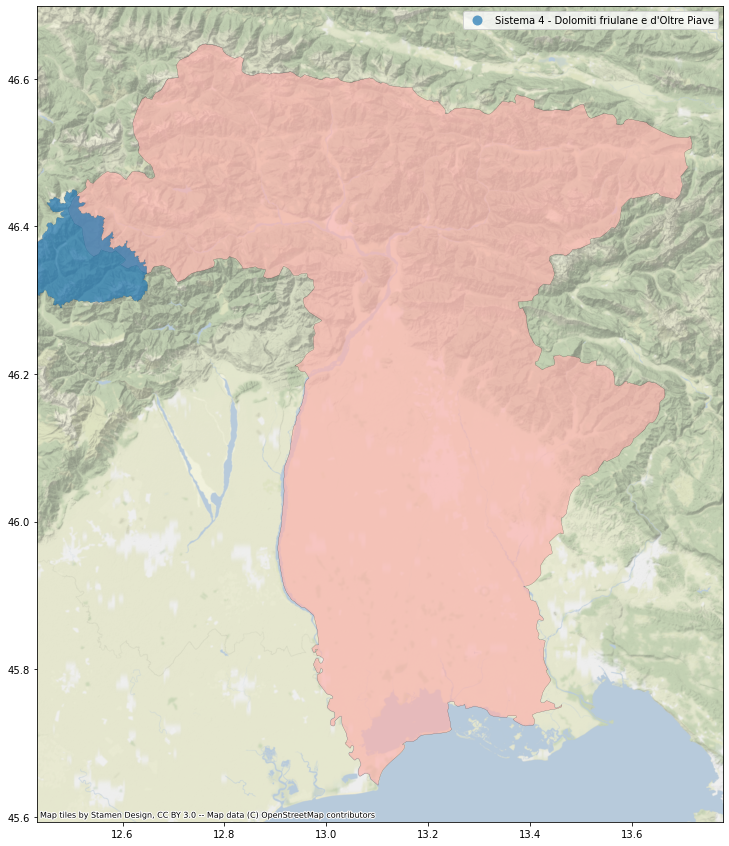

In [159]:
base = province_UD.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_UD.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_UD.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

#### Clip the Dolomiti systems geometry in order to have only the territory inside the province boudaries


In [160]:
dolomities_UD_clipped = dolomities_UD.clip(province_UD)

<AxesSubplot:>

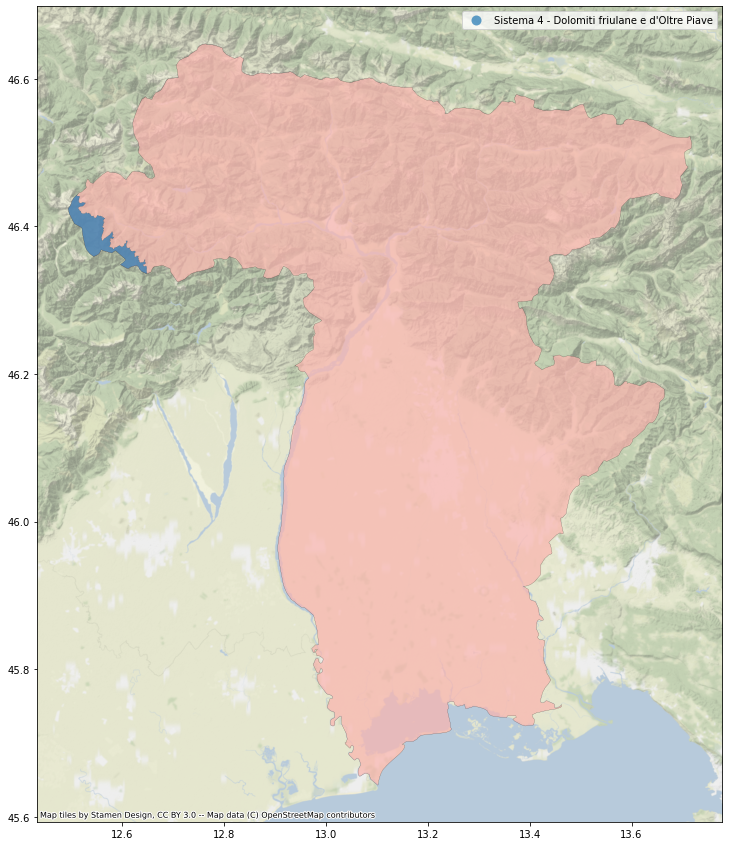

In [161]:
base = province_UD.to_crs(epsg=4326).plot(
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.7
    )
ctx.add_basemap(base, zoom=12, crs=province_UD.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)


dolomities_UD_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.70,
    lw=0.1,
    )

#### Recalculate clipped Dolomiti's territory area


In [162]:
dolomities_UD_clipped_areas= dolomities_UD_clipped.to_crs(epsg=32632)
dolomities_UD_clipped_areas["area"] = dolomities_UD_clipped_areas['geometry'].area/10**6 # for km^2
dolomities_UD_clipped_areas

,Name,Description,geometry,area,COD_REG_,COD_PROV,DEN_PROV,Shape_Area_,DEN_REG,Shape_Area_reg
3,Sistema 4 - Dolomiti friulane e d'Oltre Piave,Esplora il Sistema 4 Dolomiti friulane e d'Olt...,"POLYGON ((769649.774 5149335.876, 769631.633 5...",35.419384,6,30,Udine,4.969771e+09,Friuli Venezia Giulia,7.933911e+09


Sum the Dolomiti's areas in province of Udine:

In [163]:
dolomiti_UD_area = sum(dolomities_UD_clipped_areas.area)
print(round(dolomiti_UD_area/10**6, 2), " km\u00b2 of Dolomiti are in province of Udine", sep="")


35.42 km² of Dolomiti are in province of Udine


As it is possible to see also from the previous plots, province of Udine contains a very small Dolomiti's area.

#### Proportion of Dolomiti's territory in province of Udine


In [164]:
dolomiti_UD_area = sum(dolomities_UD_clipped_areas.area)
overal_dolomiti_area = sum(geodf_dolomities['area'])

In [165]:
persentage_dolomiti_UD = (dolomiti_UD_area/overal_dolomiti_area)*100

print("Province of Udine contains the ", round(persentage_dolomiti_UD, 2), "% of the Dolomiti's terriotory", sep="")

Province of Udine contains the 2.5% of the Dolomiti's terriotory


As expected, also the percentage is very low. And this made it the last province for the amount of Dolomiti's territory.

#### What proportion of each system does the province contain?


In [166]:
for index, row in dolomities_UD.iterrows():
    province_systems_percentage(row.DEN_PROV, row.Name)

16.5% of the 'Sistema 4 - Dolomiti friulane e d'Oltre Piave' is in province of Udine


Province of Udine contains only a small parte of *Sistema 4*.

### Dolomiti's municipalities of province of Udine
#### Get municipalities of province of Udine

In [167]:
code_UD = province_UD.COD_PROV.values[0]
code_UD

30

In [168]:
municipalities_UD = municipalities[municipalities.COD_PROV == code_UD]
municipalities_UD.head(4)

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
3600,6,30,030001,Aiello del Friuli,1.295954e+07,"POLYGON ((13.37162 45.88693, 13.37192 45.88570..."
3601,6,30,030002,Amaro,3.330734e+07,"POLYGON ((13.10669 46.41845, 13.11435 46.41627..."
3602,6,30,030003,Ampezzo,7.330908e+07,"POLYGON ((12.77522 46.47898, 12.77537 46.47816..."
3603,6,30,030004,Aquileia,3.730129e+07,"POLYGON ((13.39107 45.79862, 13.39172 45.79726..."


<AxesSubplot:>

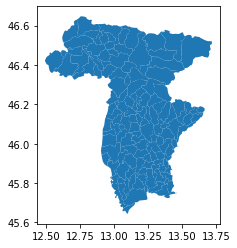

In [169]:
municipalities_UD.plot()

#### Get municipalities that contain Dolomiti's territory


In [170]:
geo_dolomiti_UD_mun = municipalities_UD[municipalities_UD.COMUNE.isin(dolomiti_mun)]

print("Municipalities in province of Udine that contain Dolomiti: ")
for i in geo_dolomiti_UD_mun.COMUNE.unique():
    print("-", i, end="\n")

Municipalities in province of Udine that contain Dolomiti: 
- Forni di Sopra
- Forni di Sotto


Only two municipalities are involved here.

<AxesSubplot:>

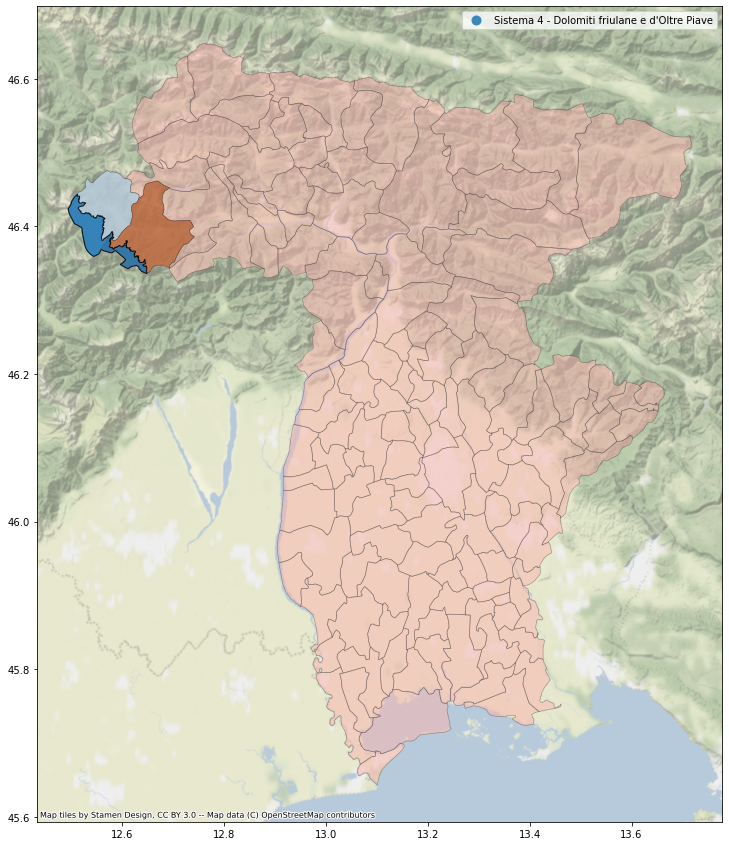

In [171]:
base = municipalities_UD.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="#413A3B",
    lw=0.6,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_UD.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

geo_dolomiti_UD_mun.to_crs(epsg=4326).plot(
    column='COMUNE',
    figsize=(15,15),
    cmap="Paired",
    edgecolor="k",
    lw=0.2,
    alpha=0.7,
    ax=base
    )

dolomities_UD_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.85,
    lw=1,
    )

#### Which is the municiplaity that contains the highest area of Dolomiti?


In [172]:
list_mun_UD = []
list_area_UD = []
list_percentage_UD = []

for index, row in geo_dolomiti_UD_mun.iterrows():
    temp = mun_systems_area(row.COMUNE)

    list_mun_UD.append(temp[0])
    list_area_UD.append(temp[1])
    list_percentage_UD.append(temp[2])

'Forni di Sopra' contains 24.53 km² of Dolomities.and the 1.7289% of the overall Dolomities territory
'Forni di Sotto' contains 10.889 km² of Dolomities.and the 0.7675% of the overall Dolomities territory


Of course also here the percentage are very low.

In [173]:
df_mun_UD = pd.DataFrame(list(zip(list_mun_UD, list_area_UD, list_percentage_UD)),
               columns =['municipality', 'Dolomiti_area', 'percentage_over_total_Dolimiti_area'])

sorted_df_UD = df_mun_UD.sort_values(by=['Dolomiti_area'], ascending=False)
sorted_df_UD

,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area
0,Forni di Sopra,2.452997e+07,1.728918
1,Forni di Sotto,1.088941e+07,0.767506


In [174]:
highest_dolomiti_area_mun_UD = sorted_df_UD[sorted_df_UD.Dolomiti_area == sorted_df_UD.Dolomiti_area.max()]
forni_di_sopra = municipalities[municipalities.COMUNE == highest_dolomiti_area_mun_UD.municipality.values[0]]
forni_di_sopra

,COD_REG,COD_PROV,PRO_COM_T,COMUNE,Shape_Area,geometry
3638,6,30,030041,Forni di Sopra,8.214593e+07,"POLYGON ((12.57608 46.47337, 12.57838 46.47358..."


<AxesSubplot:>

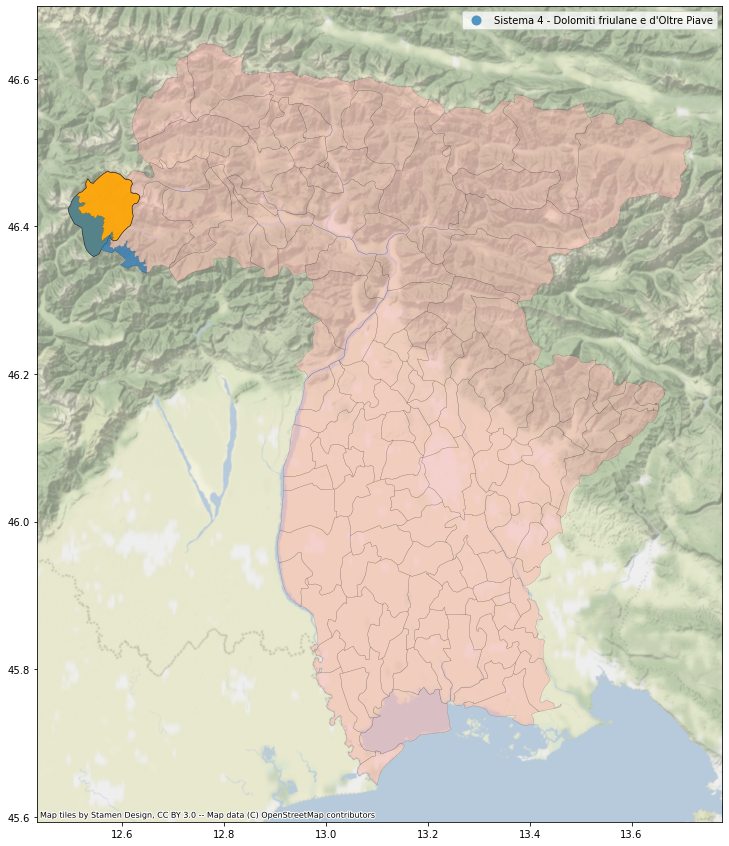

In [175]:

base = municipalities_UD.plot(
    column='COD_PROV',
    figsize=(15,15),
    cmap="Pastel1",
    edgecolor="k",
    lw=0.2,
    alpha=0.5)

ctx.add_basemap(base, crs=municipalities_UD.crs.to_string(), source=ctx.providers.Stamen.TerrainBackground, alpha=0.7)

forni_di_sopra.to_crs(epsg=4326).plot(
    figsize=(15,15),
    color="orange",
    edgecolor="k",
    lw=0.6,
    alpha=0.9,
    ax=base
    )

dolomities_UD_clipped.plot(
    column='Name',
    categorical=True,
    legend=True,
    ax=base,
    edgecolor="k",
    alpha=0.75,
    lw=0.1,
    )

**Forni di Sopra** is the municipality with the highest area of Domolomiti in the province of Udine.
Let's check if areas and percentage of the municipalities sum up to that of the province of Udine:


In [176]:
round(dolomiti_UD_area, -2) == round(sum(sorted_df_UD.Dolomiti_area), -2)

True

In [177]:
round(persentage_dolomiti_UD, 4) == round(sum(sorted_df_UD.percentage_over_total_Dolimiti_area), 4)


True

Add the two municipalities to the other Dolomiti municipalities:

In [178]:
sorted_df_UD["province"] = 'Udine'
dolomiti_municipality_rank = dolomiti_municipality_rank.append(pd.DataFrame(data = sorted_df_UD), ignore_index=True)
dolomiti_municipality_rank = dolomiti_municipality_rank.sort_values(by=['Dolomiti_area'], ascending=False)
dolomiti_municipality_rank.head(5)


,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area,province
0,Cortina d'Ampezzo,1.053706e+08,7.426714,Belluno
1,Marebbe,1.021015e+08,7.196300,Bolzano
2,Auronzo di Cadore,7.937064e+07,5.594190,Belluno
3,Cimolais,7.079494e+07,4.989759,Pordenone
4,Claut,6.322577e+07,4.456270,Pordenone


Clearly the podium remains unchanged. Let's see the position of procince of Udine municipalities:

In [179]:
dolomiti_municipality_rank[dolomiti_municipality_rank.province == 'Udine']

,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area,province
85,Forni di Sopra,2.452997e+07,1.728918,Udine
86,Forni di Sotto,1.088941e+07,0.767506,Udine


They are 16th and 34th in the overal ranking list.

### Final check: 
#### Are the municipalities Dolomiti areas sum up to the whole Dolomiti area? (more or less 1418.80)

In [180]:
sum(dolomiti_municipality_rank.Dolomiti_area)

1418804775.9299953

#### Are the municipalities percentage_over_total_Dolomiti_area sum up to 100?

In [181]:
sum(dolomiti_municipality_rank.percentage_over_total_Dolimiti_area)


99.99999999999996

### Summary: final ranking lists

#### Regions' ranking list
- 🥇 Trentino-AltoAdige
- 🥈 Veneto
- 🥉 Friuli Venezia Giulia

In [182]:
rank_dolomiti_reg

,region,dolomiti_area_km,percentage_over_total_dolimiti_area
0,Trentino-Alto Adige,646.86,45.59
1,Veneto,584.60,41.20
2,Friuli Venezia Giulia,187.35,13.20


#### Provinces' ranking list
- 🥇 Belluno (Veneto)
- 🥈 Bolzano (Trentino-Alto Adige)
- 🥉 Trento (Trentino-Alto Adige)
- 4° Pordenone (Friuli Venezia Giulia) 
- 5° Udine (Friuli Venezia Giulia)

In [183]:
data = {'region': [province_TN.DEN_PROV.values[0], province_BZ.DEN_PROV.values[0], province_BL.DEN_PROV.values[0], province_PN.DEN_PROV.values[0], province_UD.DEN_PROV.values[0]],
        'dolomiti_area_km': [round(dolomiti_TN_area/10**6, 2), round(dolomiti_BZ_area/10**6, 2), round(dolomiti_BL_area/10**6, 2), round(dolomiti_PN_area/10**6, 2), round(dolomiti_UD_area/10**6, 2)],
        'percentage_over_total_dolimiti_area': [round(persentage_dolomiti_TN, 2), round(persentage_dolomiti_BZ, 2), round(persentage_dolomiti_BL, 2), round(persentage_dolomiti_PN, 2), round(persentage_dolomiti_UD, 2)]
        }

provinces_rank = pd.DataFrame(data)
provinces_rank = provinces_rank.sort_values(by=['dolomiti_area_km'], ascending=False)
provinces_rank

,region,dolomiti_area_km,percentage_over_total_dolimiti_area
2,Belluno,584.60,41.20
1,Bolzano,439.24,30.96
0,Trento,207.62,14.63
3,Pordenone,151.93,10.71
4,Udine,35.42,2.50


#### Municipalities' ranking list
- 🥇 Cortina d'Ampezzo (Belluno, Veneto)
- 🥈 Marebbe (Bolzano, Trentino-Alto Adige)
- 🥉 Auronzo di Cadore (Belluno, Veneto)

In [184]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
dolomiti_municipality_rank

,municipality,Dolomiti_area,percentage_over_total_Dolimiti_area,province
0,Cortina d'Ampezzo,1.053706e+08,7.426714,Belluno
1,Marebbe,1.021015e+08,7.196300,Bolzano
2,Auronzo di Cadore,7.937064e+07,5.594190,Belluno
3,Cimolais,7.079494e+07,4.989759,Pordenone
4,Claut,6.322577e+07,4.456270,Pordenone
5,Taibon Agordino,6.198461e+07,4.368790,Belluno
6,Dobbiaco,5.991817e+07,4.223144,Bolzano
7,Braies,5.477485e+07,3.860633,Bolzano
8,Sedico,4.287910e+07,3.022198,Belluno
9,Primiero San Martino di Castrozza,4.132196e+07,2.912448,Trento
